## House Keeping

In [299]:
# Turn off warnings 
import sys
import warnings

if not sys.warnoptions:
    warnings.simplefilter("ignore")


In [860]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('ggplot')

import seaborn as sns
sns.set_palette("Blues", 9)

from textblob import TextBlob


In [13]:
## loading data
df = pd.read_csv('data/reviews.csv', index_col='Unnamed: 0')

In [14]:
df.head()

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [15]:
df.columns

Index(['Clothing ID', 'Age', 'Title', 'Review Text', 'Rating',
       'Recommended IND', 'Positive Feedback Count', 'Division Name',
       'Department Name', 'Class Name'],
      dtype='object')

In [311]:
# rename recommended ind
df.rename(columns={'Recommended IND': 'Recommended'}, inplace = True)

In [312]:
df.describe()

,Clothing ID,Age,Rating,Recommended,Positive Feedback Count
count,23486.000000,23486.000000,23486.000000,23486.000000,23486.000000
mean,918.118709,43.198544,4.196032,0.822362,2.535936
std,203.298980,12.279544,1.110031,0.382216,5.702202
min,0.000000,18.000000,1.000000,0.000000,0.000000
25%,861.000000,34.000000,4.000000,1.000000,0.000000
50%,936.000000,41.000000,5.000000,1.000000,1.000000
75%,1078.000000,52.000000,5.000000,1.000000,3.000000
max,1205.000000,99.000000,5.000000,1.000000,122.000000


In [17]:
df.iloc[0,3]

'Absolutely wonderful - silky and sexy and comfortable'

In [47]:
df[df['Rating']==3]

,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
10,1077,53,Dress looks like it's made of cheap material,Dress runs small esp where the zipper area run...,3,0,14,General,Dresses,Dresses
14,1077,50,Pretty party dress with some issues,This is a nice choice for holiday gatherings. ...,3,1,1,General,Dresses,Dresses
16,1065,34,"You need to be at least average height, or taller",Material and color is nice. the leg opening i...,3,1,2,General,Bottoms,Pants
23,1077,34,"Like it, but don't love it.",Cute little dress fits tts. it is a little hig...,3,1,0,General,Dresses,Dresses
...,...,...,...,...,...,...,...,...,...,...
23462,999,24,Its okay,The pattern of this skirt is adorable and look...,3,1,0,General,Bottoms,Skirts
23475,1104,41,Cute dress,Cute dress but not for me. the waist is too h...,3,1,0,General Petite,Dresses,Dresses
23482,862,48,Wish it was made of cotton,"It reminds me of maternity clothes. soft, stre...",3,1,0,General Petite,Tops,Knits
23483,1104,31,"Cute, but see through","This fit well, but the top was very see throug...",3,0,1,General Petite,Dresses,Dresses


In [35]:
df.shape

(23486, 10)

In [862]:
# Remove nan text
df.dropna(subset=['Review Text'], inplace= True)

In [863]:
df['polarity'] = df['Review Text'].apply(lambda x: TextBlob(x).sentiment.polarity)

In [34]:
# checking the unique values
df.nunique()

Clothing ID                 1206
Age                           77
Title                      13993
Review Text                22634
Rating                         5
Recommended IND                2
Positive Feedback Count       82
Division Name                  3
Department Name                6
Class Name                    20
dtype: int64

In [44]:
# get the sorted unique values of a column
np.sort(df.Age.unique())

array([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
       86, 87, 89, 90, 91, 92, 93, 94, 99])

In [50]:
# check for null values
df.isnull().sum()

Clothing ID                   0
Age                           0
Title                      3810
Review Text                 845
Rating                        0
Recommended IND               0
Positive Feedback Count       0
Division Name                14
Department Name              14
Class Name                   14
dtype: int64

### SNS Plots

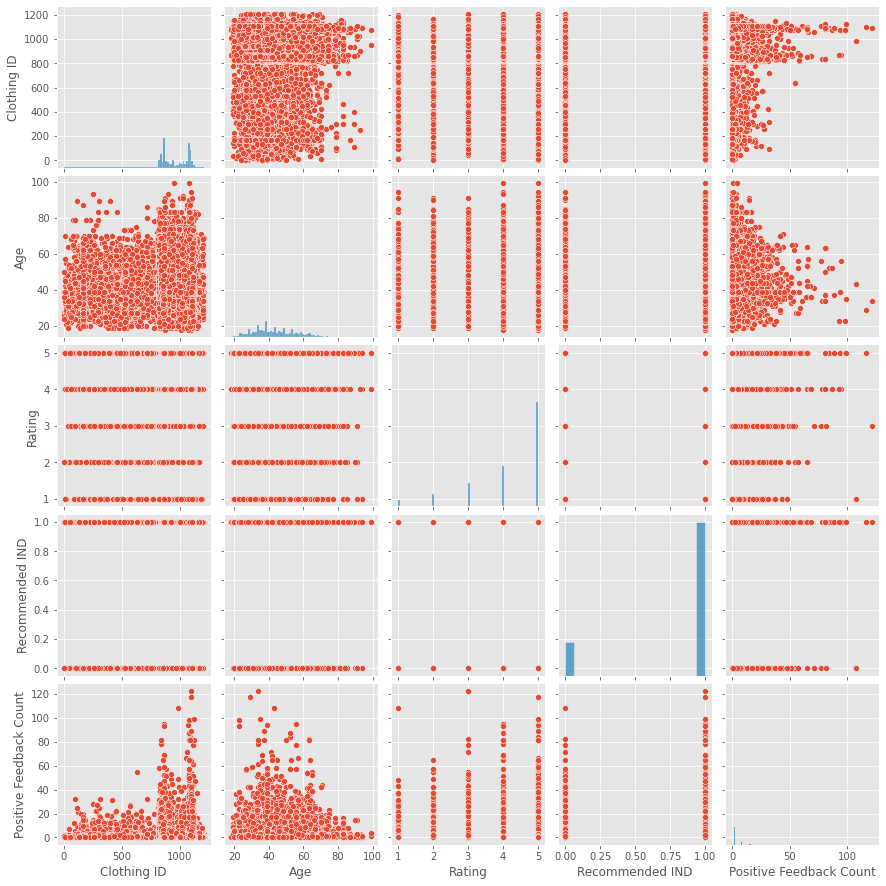

In [19]:
sns.pairplot(df)

<AxesSubplot:xlabel='Age', ylabel='count'>

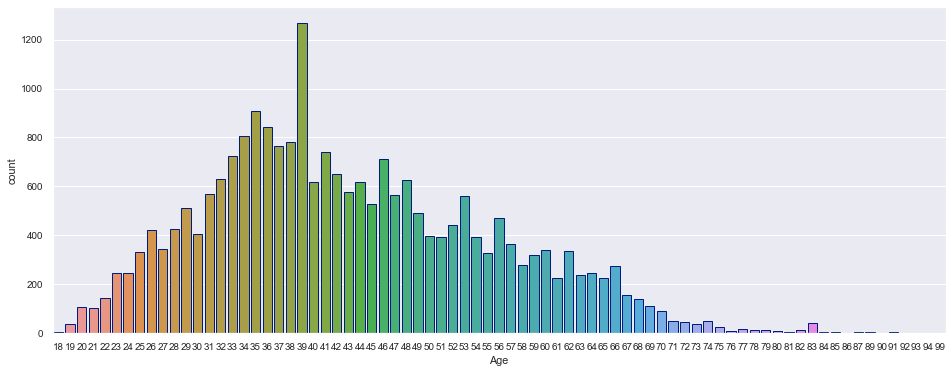

In [821]:
fig, ax = plt.subplots(figsize= (16,6))
sns.countplot(x='Age', data=df, edgecolor=sns.color_palette("dark", 1))

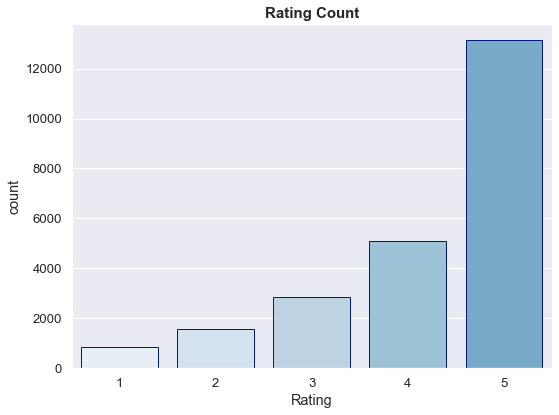

In [835]:
fig, ax = plt.subplots(figsize= (8,6))
sns.set_palette("Blues", 9)
sns.countplot(x='Rating', data=df ,edgecolor=sns.color_palette("dark", 1))\
.set_title("Rating Count",fontdict= { 'fontsize': 15, 'fontweight':'bold'} )
plt.tight_layout()
plt.savefig('images/ratingcount.png', dpi=300)

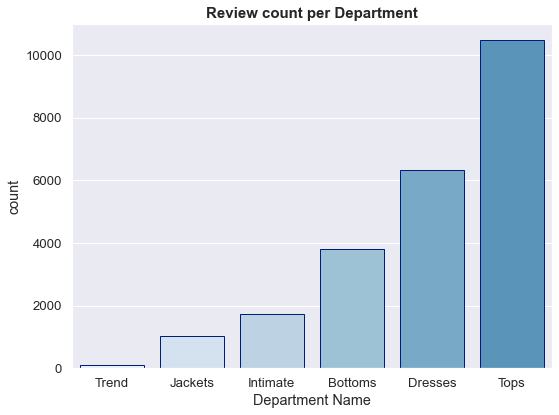

In [837]:
fig, ax = plt.subplots(figsize= (8,6))
sns.countplot(x='Department Name', data=df, edgecolor=sns.color_palette("dark", 1), order = df['Department Name'].value_counts(ascending = True).index)\
.set_title ('Review count per Department',fontdict= { 'fontsize': 15, 'fontweight':'bold'} )
plt.tight_layout()
plt.savefig('images/ReviewDepartment')

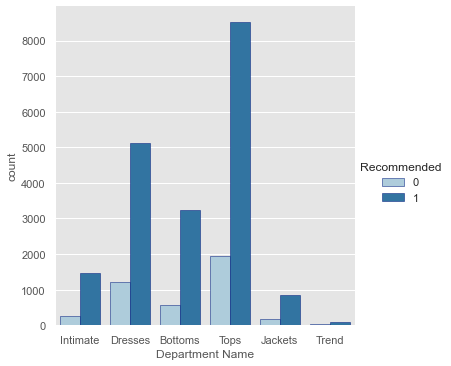

In [784]:
sns.set_palette("Paired", 9)
sns.catplot(data=df,kind='count',x='Department Name',hue='Recommended', edgecolor=sns.color_palette("dark", 1))

<AxesSubplot:>

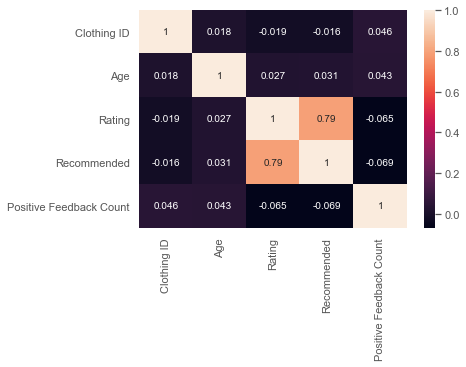

In [778]:
corelation = df.corr()
sns.heatmap(corelation, xticklabels=corelation.columns, yticklabels= corelation.columns\
           ,annot= True)

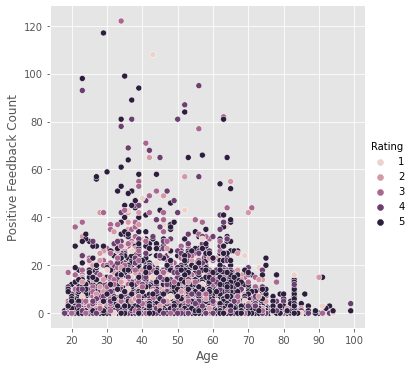

In [68]:
# good to show 3 columns at the same time
sns.relplot(x= 'Age', y ='Positive Feedback Count' , hue = 'Rating' , data= df)

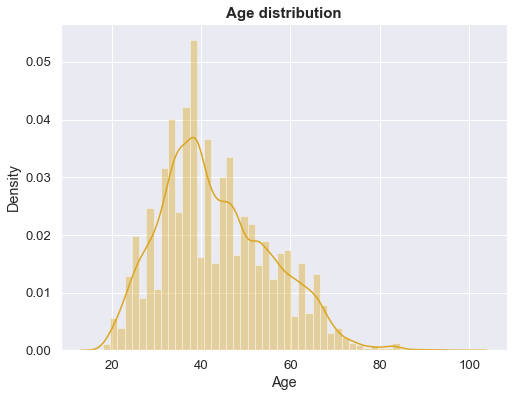

In [830]:
fig, ax = plt.subplots(figsize= (8,6))
sns.distplot(df.Age, color ='goldenrod').set_title("Age distribution",fontdict= { 'fontsize': 15, 'fontweight':'bold'} )
#sns.set(font_scale=1.2)
plt.savefig('images/agedist.png', dpi=300)

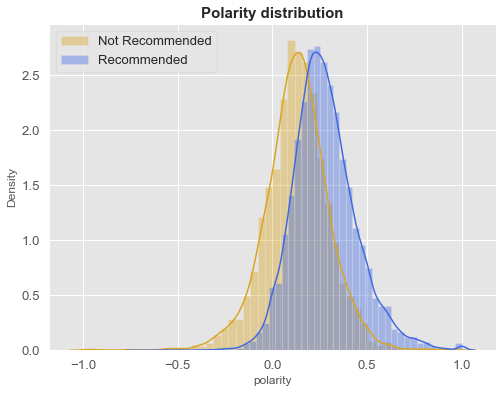

In [871]:
fig, ax = plt.subplots(figsize= (8,6))
sns.distplot(df.polarity[df.Recommended ==0], color ='goldenrod', label= 'Not Recommended').set_title("Polarity distribution",fontdict= { 'fontsize': 15, 'fontweight':'bold'} )
sns.distplot(df.polarity[df.Recommended ==1], color ='royalblue', label = 'Recommended')
#sns.set(font_scale=1.2)
plt.legend(loc= 'upper left')
plt.savefig('images/polarity-rec0.png', dpi=300)

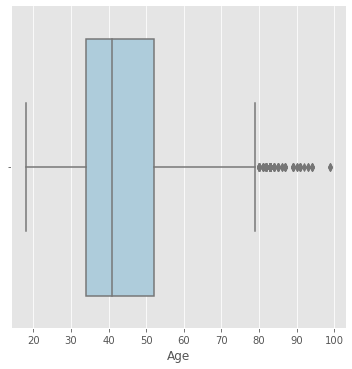

In [79]:
sns.catplot(x='Age', kind= 'box', data = df)

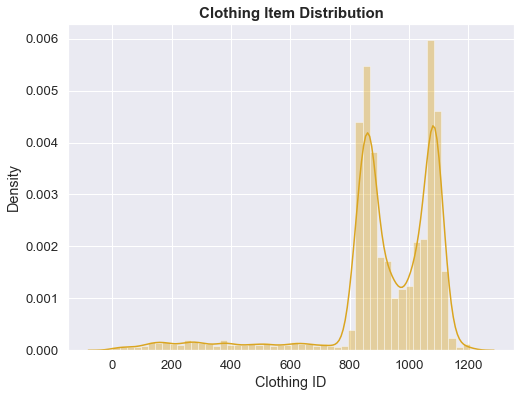

In [838]:
fig, ax = plt.subplots(figsize= (8,6))
sns.distplot(df['Clothing ID'], color ='goldenrod').set_title("Clothing Item Distribution",fontdict= { 'fontsize': 15, 'fontweight':'bold'} )
#sns.set(font_scale=1.2)
plt.savefig('images/itemdist.png', dpi=300)

## How to make 3 categories: Positive, Negative, Neutral

- Should I use textblob?
- Should I look at the data and make my own judgement?


In [89]:
df.groupby('Rating').sum()

,Clothing ID,Age,Recommended IND,Positive Feedback Count
Rating,,,,
1,771453,36790,16,2913
2,1447651,66704,94,5205
3,2664605,121037,1189,9030
4,4678000,217740,4909,12213
5,12001227,572290,13106,30198


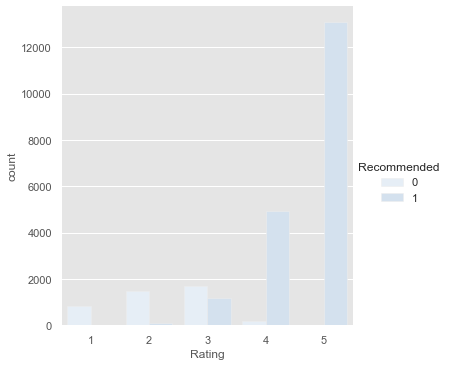

In [782]:
sns.color_palette("dark:salmon_r", as_cmap=True)
sns.catplot(data=df,kind='count',x='Rating',hue='Recommended')

In [316]:
df_trial= df[['Rating','Recommended']].groupby('Rating')['Recommended'].value_counts(normalize = True)

In [107]:
df_trial = 

Rating  Recommended IND
1       0                  0.980998
        1                  0.019002
2       0                  0.939936
        1                  0.060064
3       0                  0.585859
        1                  0.414141
4       1                  0.966910
        0                  0.033090
5       1                  0.998096
        0                  0.001904
Name: Recommended IND, dtype: float64

In [103]:
type(df_trial)

pandas.core.series.Series

In [317]:
df[['Rating','Recommended']].reset_index(drop= True)

,Rating,Recommended
0,4,1
1,5,1
2,3,0
3,5,1
4,5,1
...,...,...
23481,5,1
23482,3,1
23483,3,0
23484,3,1


In [787]:
new= df[['Rating','Recommended']].groupby('Rating')['Recommended'].value_counts(normalize = True)\
.rename('Percentage').mul(100).reset_index()

In [788]:
new

,Rating,Recommended,Percentage
0,1,0,98.099762
1,1,1,1.900238
2,2,0,93.993610
3,2,1,6.006390
4,3,0,58.585859
5,3,1,41.414141
6,4,1,96.690959
7,4,0,3.309041
8,5,1,99.809611
9,5,0,0.190389


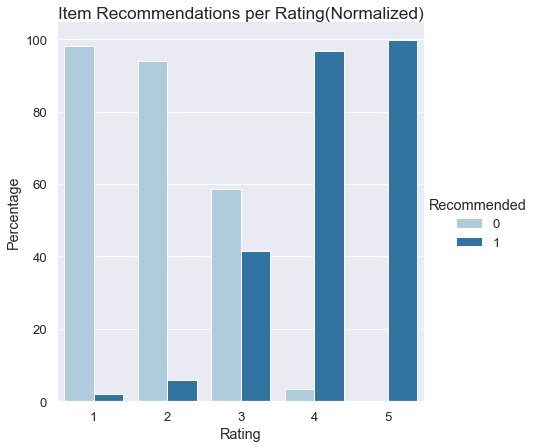

In [859]:
#sns.set()
#p = sns.catplot(data=new,x='Rating',y = 'Percentage' ,hue='Recommended', kind = 'bar')
#p.set_xlabel("X-Axis", fontsize = 20)
#p.set_ylabel("Y-Axis", fontsize = 20)
#p.set_title("Rating vs Recommended (Normalized)", fontsize = 20)
sns.set_palette("Paired", 9)
p= sns.catplot(data=new,x='Rating',y = 'Percentage' ,hue='Recommended', kind = 'bar', height= 6)
p.fig.suptitle("Item Recommendations per Rating(Normalized)",fontdict= { 'fontsize': 12, 'fontweight':'bold'} ,x=0.45, y= 1)
#plt.tight_layout()
plt.savefig('images/ratevsrec.png', dpi= 300)

In [113]:
type(t)

pandas.core.frame.DataFrame

## Grabbing the text

In [151]:
df.columns

Index(['Clothing ID', 'Age', 'Title', 'Review Text', 'Rating',
       'Recommended IND', 'Positive Feedback Count', 'Division Name',
       'Department Name', 'Class Name'],
      dtype='object')

In [321]:
text_df= df[['Review Text', 'Rating',
       'Recommended']]

In [322]:
text_df.head()

,Review Text,Rating,Recommended
0,Absolutely wonderful - silky and sexy and comf...,4,1
1,Love this dress! it's sooo pretty. i happene...,5,1
2,I had such high hopes for this dress and reall...,3,0
3,"I love, love, love this jumpsuit. it's fun, fl...",5,1
4,This shirt is very flattering to all due to th...,5,1


In [158]:
# clean the text:

import nltk
import string
from nltk.util import ngrams
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer

import unicodedata

In [186]:
#def norm(string):
    #return unicodedata.normalize('NFKD', string).encode('ASCII','ignore').decode('ASCII')

text_df['CT'] = unicodedata.normalize('NFKD', text_df['Review Text']).encode('ASCII','ignore').decode('ASCII')

text_df

TypeError: normalize() argument 2 must be str, not Series

In [195]:
a=0
for i in text_df['Review Text']:
    a+=1
    print(a , type(i))

1 <class 'str'>
2 <class 'str'>
3 <class 'str'>
4 <class 'str'>
5 <class 'str'>
6 <class 'str'>
7 <class 'str'>
8 <class 'str'>
9 <class 'str'>
10 <class 'str'>
11 <class 'str'>
12 <class 'str'>
13 <class 'str'>
14 <class 'str'>
15 <class 'str'>
16 <class 'str'>
17 <class 'str'>
18 <class 'str'>
19 <class 'str'>
20 <class 'str'>
21 <class 'str'>
22 <class 'str'>
23 <class 'str'>
24 <class 'str'>
25 <class 'str'>
26 <class 'str'>
27 <class 'str'>
28 <class 'str'>
29 <class 'str'>
30 <class 'str'>
31 <class 'str'>
32 <class 'str'>
33 <class 'str'>
34 <class 'str'>
35 <class 'str'>
36 <class 'str'>
37 <class 'str'>
38 <class 'str'>
39 <class 'str'>
40 <class 'str'>
41 <class 'str'>
42 <class 'str'>
43 <class 'str'>
44 <class 'str'>
45 <class 'str'>
46 <class 'str'>
47 <class 'str'>
48 <class 'str'>
49 <class 'str'>
50 <class 'str'>
51 <class 'str'>
52 <class 'str'>
53 <class 'str'>
54 <class 'str'>
55 <class 'str'>
56 <class 'str'>
57 <class 'str'>
58 <class 'str'>
59 <class 'str'>
60 <cl

643 <class 'str'>
644 <class 'str'>
645 <class 'str'>
646 <class 'str'>
647 <class 'str'>
648 <class 'str'>
649 <class 'str'>
650 <class 'str'>
651 <class 'str'>
652 <class 'str'>
653 <class 'str'>
654 <class 'str'>
655 <class 'str'>
656 <class 'str'>
657 <class 'str'>
658 <class 'str'>
659 <class 'str'>
660 <class 'str'>
661 <class 'str'>
662 <class 'str'>
663 <class 'str'>
664 <class 'str'>
665 <class 'str'>
666 <class 'str'>
667 <class 'str'>
668 <class 'str'>
669 <class 'str'>
670 <class 'str'>
671 <class 'str'>
672 <class 'str'>
673 <class 'str'>
674 <class 'str'>
675 <class 'str'>
676 <class 'str'>
677 <class 'str'>
678 <class 'str'>
679 <class 'str'>
680 <class 'str'>
681 <class 'str'>
682 <class 'str'>
683 <class 'str'>
684 <class 'str'>
685 <class 'str'>
686 <class 'str'>
687 <class 'float'>
688 <class 'str'>
689 <class 'str'>
690 <class 'str'>
691 <class 'str'>
692 <class 'str'>
693 <class 'str'>
694 <class 'str'>
695 <class 'str'>
696 <class 'str'>
697 <class 'str'>
698 <cla

1142 <class 'str'>
1143 <class 'str'>
1144 <class 'str'>
1145 <class 'str'>
1146 <class 'str'>
1147 <class 'str'>
1148 <class 'str'>
1149 <class 'str'>
1150 <class 'str'>
1151 <class 'str'>
1152 <class 'str'>
1153 <class 'str'>
1154 <class 'str'>
1155 <class 'str'>
1156 <class 'str'>
1157 <class 'str'>
1158 <class 'str'>
1159 <class 'str'>
1160 <class 'str'>
1161 <class 'str'>
1162 <class 'str'>
1163 <class 'str'>
1164 <class 'str'>
1165 <class 'str'>
1166 <class 'str'>
1167 <class 'str'>
1168 <class 'str'>
1169 <class 'str'>
1170 <class 'str'>
1171 <class 'str'>
1172 <class 'str'>
1173 <class 'str'>
1174 <class 'str'>
1175 <class 'str'>
1176 <class 'str'>
1177 <class 'str'>
1178 <class 'str'>
1179 <class 'str'>
1180 <class 'str'>
1181 <class 'str'>
1182 <class 'str'>
1183 <class 'str'>
1184 <class 'str'>
1185 <class 'str'>
1186 <class 'str'>
1187 <class 'str'>
1188 <class 'str'>
1189 <class 'str'>
1190 <class 'str'>
1191 <class 'str'>
1192 <class 'str'>
1193 <class 'str'>
1194 <class 

1642 <class 'str'>
1643 <class 'str'>
1644 <class 'float'>
1645 <class 'str'>
1646 <class 'str'>
1647 <class 'str'>
1648 <class 'str'>
1649 <class 'str'>
1650 <class 'str'>
1651 <class 'str'>
1652 <class 'str'>
1653 <class 'str'>
1654 <class 'str'>
1655 <class 'str'>
1656 <class 'str'>
1657 <class 'str'>
1658 <class 'str'>
1659 <class 'str'>
1660 <class 'str'>
1661 <class 'float'>
1662 <class 'str'>
1663 <class 'str'>
1664 <class 'str'>
1665 <class 'str'>
1666 <class 'str'>
1667 <class 'str'>
1668 <class 'str'>
1669 <class 'str'>
1670 <class 'str'>
1671 <class 'str'>
1672 <class 'str'>
1673 <class 'str'>
1674 <class 'str'>
1675 <class 'str'>
1676 <class 'str'>
1677 <class 'str'>
1678 <class 'str'>
1679 <class 'str'>
1680 <class 'str'>
1681 <class 'str'>
1682 <class 'str'>
1683 <class 'str'>
1684 <class 'str'>
1685 <class 'str'>
1686 <class 'str'>
1687 <class 'str'>
1688 <class 'str'>
1689 <class 'str'>
1690 <class 'str'>
1691 <class 'str'>
1692 <class 'str'>
1693 <class 'str'>
1694 <cl

2142 <class 'str'>
2143 <class 'str'>
2144 <class 'str'>
2145 <class 'str'>
2146 <class 'str'>
2147 <class 'str'>
2148 <class 'str'>
2149 <class 'str'>
2150 <class 'float'>
2151 <class 'str'>
2152 <class 'str'>
2153 <class 'str'>
2154 <class 'str'>
2155 <class 'str'>
2156 <class 'str'>
2157 <class 'str'>
2158 <class 'str'>
2159 <class 'str'>
2160 <class 'str'>
2161 <class 'float'>
2162 <class 'str'>
2163 <class 'str'>
2164 <class 'str'>
2165 <class 'str'>
2166 <class 'str'>
2167 <class 'str'>
2168 <class 'str'>
2169 <class 'str'>
2170 <class 'str'>
2171 <class 'str'>
2172 <class 'str'>
2173 <class 'str'>
2174 <class 'str'>
2175 <class 'float'>
2176 <class 'str'>
2177 <class 'str'>
2178 <class 'str'>
2179 <class 'str'>
2180 <class 'str'>
2181 <class 'str'>
2182 <class 'str'>
2183 <class 'str'>
2184 <class 'str'>
2185 <class 'str'>
2186 <class 'str'>
2187 <class 'str'>
2188 <class 'str'>
2189 <class 'str'>
2190 <class 'str'>
2191 <class 'str'>
2192 <class 'str'>
2193 <class 'str'>
2194 <

2891 <class 'str'>
2892 <class 'str'>
2893 <class 'str'>
2894 <class 'str'>
2895 <class 'str'>
2896 <class 'str'>
2897 <class 'str'>
2898 <class 'str'>
2899 <class 'str'>
2900 <class 'str'>
2901 <class 'str'>
2902 <class 'str'>
2903 <class 'str'>
2904 <class 'str'>
2905 <class 'str'>
2906 <class 'str'>
2907 <class 'str'>
2908 <class 'str'>
2909 <class 'str'>
2910 <class 'str'>
2911 <class 'str'>
2912 <class 'str'>
2913 <class 'str'>
2914 <class 'str'>
2915 <class 'str'>
2916 <class 'str'>
2917 <class 'str'>
2918 <class 'str'>
2919 <class 'str'>
2920 <class 'str'>
2921 <class 'str'>
2922 <class 'str'>
2923 <class 'str'>
2924 <class 'str'>
2925 <class 'str'>
2926 <class 'str'>
2927 <class 'str'>
2928 <class 'str'>
2929 <class 'str'>
2930 <class 'str'>
2931 <class 'str'>
2932 <class 'str'>
2933 <class 'str'>
2934 <class 'str'>
2935 <class 'str'>
2936 <class 'str'>
2937 <class 'str'>
2938 <class 'str'>
2939 <class 'float'>
2940 <class 'str'>
2941 <class 'str'>
2942 <class 'float'>
2943 <cl

3391 <class 'str'>
3392 <class 'str'>
3393 <class 'str'>
3394 <class 'str'>
3395 <class 'str'>
3396 <class 'str'>
3397 <class 'str'>
3398 <class 'str'>
3399 <class 'str'>
3400 <class 'float'>
3401 <class 'str'>
3402 <class 'str'>
3403 <class 'str'>
3404 <class 'str'>
3405 <class 'str'>
3406 <class 'str'>
3407 <class 'str'>
3408 <class 'str'>
3409 <class 'str'>
3410 <class 'str'>
3411 <class 'str'>
3412 <class 'str'>
3413 <class 'str'>
3414 <class 'str'>
3415 <class 'str'>
3416 <class 'str'>
3417 <class 'str'>
3418 <class 'str'>
3419 <class 'float'>
3420 <class 'str'>
3421 <class 'str'>
3422 <class 'str'>
3423 <class 'str'>
3424 <class 'str'>
3425 <class 'str'>
3426 <class 'str'>
3427 <class 'str'>
3428 <class 'str'>
3429 <class 'str'>
3430 <class 'str'>
3431 <class 'str'>
3432 <class 'str'>
3433 <class 'str'>
3434 <class 'str'>
3435 <class 'str'>
3436 <class 'str'>
3437 <class 'str'>
3438 <class 'str'>
3439 <class 'float'>
3440 <class 'str'>
3441 <class 'str'>
3442 <class 'str'>
3443 <

3890 <class 'str'>
3891 <class 'str'>
3892 <class 'str'>
3893 <class 'str'>
3894 <class 'str'>
3895 <class 'str'>
3896 <class 'str'>
3897 <class 'str'>
3898 <class 'str'>
3899 <class 'str'>
3900 <class 'str'>
3901 <class 'str'>
3902 <class 'str'>
3903 <class 'str'>
3904 <class 'str'>
3905 <class 'str'>
3906 <class 'str'>
3907 <class 'str'>
3908 <class 'str'>
3909 <class 'str'>
3910 <class 'float'>
3911 <class 'str'>
3912 <class 'str'>
3913 <class 'str'>
3914 <class 'float'>
3915 <class 'str'>
3916 <class 'str'>
3917 <class 'str'>
3918 <class 'str'>
3919 <class 'str'>
3920 <class 'str'>
3921 <class 'str'>
3922 <class 'str'>
3923 <class 'str'>
3924 <class 'str'>
3925 <class 'str'>
3926 <class 'str'>
3927 <class 'str'>
3928 <class 'str'>
3929 <class 'str'>
3930 <class 'str'>
3931 <class 'str'>
3932 <class 'str'>
3933 <class 'str'>
3934 <class 'str'>
3935 <class 'str'>
3936 <class 'str'>
3937 <class 'str'>
3938 <class 'str'>
3939 <class 'str'>
3940 <class 'str'>
3941 <class 'str'>
3942 <cl

4390 <class 'str'>
4391 <class 'str'>
4392 <class 'str'>
4393 <class 'str'>
4394 <class 'str'>
4395 <class 'str'>
4396 <class 'str'>
4397 <class 'str'>
4398 <class 'str'>
4399 <class 'str'>
4400 <class 'str'>
4401 <class 'str'>
4402 <class 'str'>
4403 <class 'str'>
4404 <class 'str'>
4405 <class 'str'>
4406 <class 'str'>
4407 <class 'str'>
4408 <class 'str'>
4409 <class 'str'>
4410 <class 'str'>
4411 <class 'str'>
4412 <class 'str'>
4413 <class 'str'>
4414 <class 'str'>
4415 <class 'str'>
4416 <class 'str'>
4417 <class 'str'>
4418 <class 'str'>
4419 <class 'str'>
4420 <class 'str'>
4421 <class 'str'>
4422 <class 'str'>
4423 <class 'str'>
4424 <class 'str'>
4425 <class 'str'>
4426 <class 'str'>
4427 <class 'float'>
4428 <class 'str'>
4429 <class 'str'>
4430 <class 'str'>
4431 <class 'str'>
4432 <class 'str'>
4433 <class 'str'>
4434 <class 'str'>
4435 <class 'str'>
4436 <class 'str'>
4437 <class 'str'>
4438 <class 'str'>
4439 <class 'str'>
4440 <class 'str'>
4441 <class 'str'>
4442 <clas

4890 <class 'str'>
4891 <class 'str'>
4892 <class 'str'>
4893 <class 'str'>
4894 <class 'str'>
4895 <class 'str'>
4896 <class 'str'>
4897 <class 'float'>
4898 <class 'str'>
4899 <class 'str'>
4900 <class 'str'>
4901 <class 'str'>
4902 <class 'str'>
4903 <class 'str'>
4904 <class 'str'>
4905 <class 'str'>
4906 <class 'str'>
4907 <class 'str'>
4908 <class 'str'>
4909 <class 'str'>
4910 <class 'float'>
4911 <class 'str'>
4912 <class 'str'>
4913 <class 'str'>
4914 <class 'str'>
4915 <class 'str'>
4916 <class 'str'>
4917 <class 'float'>
4918 <class 'str'>
4919 <class 'str'>
4920 <class 'str'>
4921 <class 'str'>
4922 <class 'str'>
4923 <class 'float'>
4924 <class 'str'>
4925 <class 'str'>
4926 <class 'str'>
4927 <class 'str'>
4928 <class 'str'>
4929 <class 'str'>
4930 <class 'str'>
4931 <class 'str'>
4932 <class 'str'>
4933 <class 'str'>
4934 <class 'str'>
4935 <class 'str'>
4936 <class 'str'>
4937 <class 'str'>
4938 <class 'str'>
4939 <class 'str'>
4940 <class 'str'>
4941 <class 'str'>
4942

5390 <class 'str'>
5391 <class 'str'>
5392 <class 'str'>
5393 <class 'float'>
5394 <class 'str'>
5395 <class 'str'>
5396 <class 'str'>
5397 <class 'str'>
5398 <class 'str'>
5399 <class 'str'>
5400 <class 'str'>
5401 <class 'str'>
5402 <class 'str'>
5403 <class 'str'>
5404 <class 'str'>
5405 <class 'str'>
5406 <class 'str'>
5407 <class 'str'>
5408 <class 'str'>
5409 <class 'str'>
5410 <class 'str'>
5411 <class 'str'>
5412 <class 'str'>
5413 <class 'str'>
5414 <class 'str'>
5415 <class 'str'>
5416 <class 'str'>
5417 <class 'str'>
5418 <class 'str'>
5419 <class 'str'>
5420 <class 'str'>
5421 <class 'str'>
5422 <class 'str'>
5423 <class 'str'>
5424 <class 'str'>
5425 <class 'str'>
5426 <class 'str'>
5427 <class 'str'>
5428 <class 'str'>
5429 <class 'str'>
5430 <class 'str'>
5431 <class 'str'>
5432 <class 'str'>
5433 <class 'float'>
5434 <class 'str'>
5435 <class 'str'>
5436 <class 'str'>
5437 <class 'str'>
5438 <class 'str'>
5439 <class 'str'>
5440 <class 'str'>
5441 <class 'str'>
5442 <cl

6139 <class 'str'>
6140 <class 'str'>
6141 <class 'str'>
6142 <class 'str'>
6143 <class 'str'>
6144 <class 'str'>
6145 <class 'str'>
6146 <class 'str'>
6147 <class 'str'>
6148 <class 'str'>
6149 <class 'str'>
6150 <class 'str'>
6151 <class 'str'>
6152 <class 'str'>
6153 <class 'str'>
6154 <class 'str'>
6155 <class 'str'>
6156 <class 'str'>
6157 <class 'str'>
6158 <class 'str'>
6159 <class 'str'>
6160 <class 'str'>
6161 <class 'str'>
6162 <class 'str'>
6163 <class 'str'>
6164 <class 'str'>
6165 <class 'str'>
6166 <class 'str'>
6167 <class 'str'>
6168 <class 'str'>
6169 <class 'str'>
6170 <class 'str'>
6171 <class 'str'>
6172 <class 'str'>
6173 <class 'str'>
6174 <class 'str'>
6175 <class 'str'>
6176 <class 'str'>
6177 <class 'str'>
6178 <class 'str'>
6179 <class 'str'>
6180 <class 'str'>
6181 <class 'str'>
6182 <class 'str'>
6183 <class 'str'>
6184 <class 'str'>
6185 <class 'str'>
6186 <class 'str'>
6187 <class 'str'>
6188 <class 'str'>
6189 <class 'str'>
6190 <class 'str'>
6191 <class 

6639 <class 'float'>
6640 <class 'str'>
6641 <class 'str'>
6642 <class 'str'>
6643 <class 'float'>
6644 <class 'str'>
6645 <class 'str'>
6646 <class 'str'>
6647 <class 'str'>
6648 <class 'str'>
6649 <class 'str'>
6650 <class 'str'>
6651 <class 'str'>
6652 <class 'str'>
6653 <class 'str'>
6654 <class 'str'>
6655 <class 'str'>
6656 <class 'str'>
6657 <class 'str'>
6658 <class 'str'>
6659 <class 'str'>
6660 <class 'str'>
6661 <class 'str'>
6662 <class 'str'>
6663 <class 'str'>
6664 <class 'str'>
6665 <class 'str'>
6666 <class 'str'>
6667 <class 'str'>
6668 <class 'str'>
6669 <class 'str'>
6670 <class 'str'>
6671 <class 'str'>
6672 <class 'str'>
6673 <class 'str'>
6674 <class 'str'>
6675 <class 'str'>
6676 <class 'str'>
6677 <class 'str'>
6678 <class 'str'>
6679 <class 'str'>
6680 <class 'str'>
6681 <class 'str'>
6682 <class 'float'>
6683 <class 'str'>
6684 <class 'str'>
6685 <class 'str'>
6686 <class 'str'>
6687 <class 'str'>
6688 <class 'str'>
6689 <class 'str'>
6690 <class 'str'>
6691 <

7139 <class 'str'>
7140 <class 'str'>
7141 <class 'str'>
7142 <class 'str'>
7143 <class 'str'>
7144 <class 'str'>
7145 <class 'str'>
7146 <class 'str'>
7147 <class 'str'>
7148 <class 'str'>
7149 <class 'str'>
7150 <class 'str'>
7151 <class 'str'>
7152 <class 'str'>
7153 <class 'str'>
7154 <class 'str'>
7155 <class 'str'>
7156 <class 'str'>
7157 <class 'str'>
7158 <class 'str'>
7159 <class 'str'>
7160 <class 'str'>
7161 <class 'str'>
7162 <class 'str'>
7163 <class 'str'>
7164 <class 'str'>
7165 <class 'str'>
7166 <class 'str'>
7167 <class 'str'>
7168 <class 'str'>
7169 <class 'str'>
7170 <class 'str'>
7171 <class 'str'>
7172 <class 'str'>
7173 <class 'str'>
7174 <class 'str'>
7175 <class 'str'>
7176 <class 'str'>
7177 <class 'float'>
7178 <class 'str'>
7179 <class 'str'>
7180 <class 'str'>
7181 <class 'str'>
7182 <class 'str'>
7183 <class 'str'>
7184 <class 'str'>
7185 <class 'str'>
7186 <class 'str'>
7187 <class 'str'>
7188 <class 'str'>
7189 <class 'str'>
7190 <class 'str'>
7191 <clas

7613 <class 'str'>
7614 <class 'str'>
7615 <class 'str'>
7616 <class 'str'>
7617 <class 'str'>
7618 <class 'str'>
7619 <class 'str'>
7620 <class 'str'>
7621 <class 'str'>
7622 <class 'str'>
7623 <class 'str'>
7624 <class 'str'>
7625 <class 'str'>
7626 <class 'str'>
7627 <class 'str'>
7628 <class 'str'>
7629 <class 'str'>
7630 <class 'str'>
7631 <class 'str'>
7632 <class 'str'>
7633 <class 'str'>
7634 <class 'str'>
7635 <class 'str'>
7636 <class 'str'>
7637 <class 'str'>
7638 <class 'str'>
7639 <class 'str'>
7640 <class 'str'>
7641 <class 'str'>
7642 <class 'str'>
7643 <class 'str'>
7644 <class 'str'>
7645 <class 'str'>
7646 <class 'str'>
7647 <class 'str'>
7648 <class 'str'>
7649 <class 'str'>
7650 <class 'str'>
7651 <class 'str'>
7652 <class 'str'>
7653 <class 'str'>
7654 <class 'str'>
7655 <class 'str'>
7656 <class 'str'>
7657 <class 'str'>
7658 <class 'str'>
7659 <class 'str'>
7660 <class 'str'>
7661 <class 'str'>
7662 <class 'str'>
7663 <class 'str'>
7664 <class 'str'>
7665 <class 

8330 <class 'str'>
8331 <class 'str'>
8332 <class 'str'>
8333 <class 'str'>
8334 <class 'str'>
8335 <class 'str'>
8336 <class 'str'>
8337 <class 'str'>
8338 <class 'str'>
8339 <class 'str'>
8340 <class 'float'>
8341 <class 'str'>
8342 <class 'str'>
8343 <class 'str'>
8344 <class 'str'>
8345 <class 'str'>
8346 <class 'float'>
8347 <class 'str'>
8348 <class 'str'>
8349 <class 'str'>
8350 <class 'str'>
8351 <class 'str'>
8352 <class 'str'>
8353 <class 'str'>
8354 <class 'str'>
8355 <class 'str'>
8356 <class 'str'>
8357 <class 'str'>
8358 <class 'str'>
8359 <class 'str'>
8360 <class 'str'>
8361 <class 'str'>
8362 <class 'str'>
8363 <class 'str'>
8364 <class 'str'>
8365 <class 'str'>
8366 <class 'str'>
8367 <class 'str'>
8368 <class 'str'>
8369 <class 'str'>
8370 <class 'str'>
8371 <class 'str'>
8372 <class 'str'>
8373 <class 'str'>
8374 <class 'str'>
8375 <class 'str'>
8376 <class 'str'>
8377 <class 'str'>
8378 <class 'str'>
8379 <class 'str'>
8380 <class 'str'>
8381 <class 'str'>
8382 <cl

8841 <class 'str'>
8842 <class 'str'>
8843 <class 'str'>
8844 <class 'str'>
8845 <class 'str'>
8846 <class 'str'>
8847 <class 'str'>
8848 <class 'str'>
8849 <class 'str'>
8850 <class 'str'>
8851 <class 'str'>
8852 <class 'str'>
8853 <class 'str'>
8854 <class 'str'>
8855 <class 'str'>
8856 <class 'str'>
8857 <class 'str'>
8858 <class 'str'>
8859 <class 'str'>
8860 <class 'str'>
8861 <class 'str'>
8862 <class 'str'>
8863 <class 'str'>
8864 <class 'str'>
8865 <class 'str'>
8866 <class 'str'>
8867 <class 'str'>
8868 <class 'str'>
8869 <class 'str'>
8870 <class 'str'>
8871 <class 'str'>
8872 <class 'str'>
8873 <class 'str'>
8874 <class 'str'>
8875 <class 'str'>
8876 <class 'str'>
8877 <class 'str'>
8878 <class 'str'>
8879 <class 'str'>
8880 <class 'str'>
8881 <class 'str'>
8882 <class 'str'>
8883 <class 'str'>
8884 <class 'str'>
8885 <class 'str'>
8886 <class 'str'>
8887 <class 'str'>
8888 <class 'str'>
8889 <class 'str'>
8890 <class 'str'>
8891 <class 'str'>
8892 <class 'str'>
8893 <class 

9637 <class 'str'>
9638 <class 'str'>
9639 <class 'str'>
9640 <class 'str'>
9641 <class 'str'>
9642 <class 'str'>
9643 <class 'str'>
9644 <class 'str'>
9645 <class 'str'>
9646 <class 'str'>
9647 <class 'str'>
9648 <class 'str'>
9649 <class 'float'>
9650 <class 'str'>
9651 <class 'str'>
9652 <class 'str'>
9653 <class 'str'>
9654 <class 'str'>
9655 <class 'str'>
9656 <class 'str'>
9657 <class 'str'>
9658 <class 'str'>
9659 <class 'str'>
9660 <class 'str'>
9661 <class 'str'>
9662 <class 'str'>
9663 <class 'str'>
9664 <class 'str'>
9665 <class 'str'>
9666 <class 'str'>
9667 <class 'str'>
9668 <class 'str'>
9669 <class 'float'>
9670 <class 'str'>
9671 <class 'str'>
9672 <class 'float'>
9673 <class 'str'>
9674 <class 'str'>
9675 <class 'str'>
9676 <class 'str'>
9677 <class 'str'>
9678 <class 'float'>
9679 <class 'str'>
9680 <class 'str'>
9681 <class 'str'>
9682 <class 'str'>
9683 <class 'str'>
9684 <class 'str'>
9685 <class 'str'>
9686 <class 'str'>
9687 <class 'str'>
9688 <class 'str'>
9689

10511 <class 'str'>
10512 <class 'float'>
10513 <class 'str'>
10514 <class 'str'>
10515 <class 'float'>
10516 <class 'str'>
10517 <class 'str'>
10518 <class 'str'>
10519 <class 'str'>
10520 <class 'str'>
10521 <class 'str'>
10522 <class 'str'>
10523 <class 'str'>
10524 <class 'str'>
10525 <class 'str'>
10526 <class 'str'>
10527 <class 'str'>
10528 <class 'str'>
10529 <class 'str'>
10530 <class 'str'>
10531 <class 'str'>
10532 <class 'str'>
10533 <class 'str'>
10534 <class 'str'>
10535 <class 'str'>
10536 <class 'str'>
10537 <class 'str'>
10538 <class 'str'>
10539 <class 'str'>
10540 <class 'str'>
10541 <class 'str'>
10542 <class 'str'>
10543 <class 'str'>
10544 <class 'str'>
10545 <class 'str'>
10546 <class 'str'>
10547 <class 'str'>
10548 <class 'str'>
10549 <class 'str'>
10550 <class 'str'>
10551 <class 'str'>
10552 <class 'str'>
10553 <class 'str'>
10554 <class 'str'>
10555 <class 'str'>
10556 <class 'str'>
10557 <class 'str'>
10558 <class 'str'>
10559 <class 'str'>
10560 <class 'st

11326 <class 'str'>
11327 <class 'str'>
11328 <class 'str'>
11329 <class 'str'>
11330 <class 'str'>
11331 <class 'str'>
11332 <class 'str'>
11333 <class 'str'>
11334 <class 'float'>
11335 <class 'str'>
11336 <class 'str'>
11337 <class 'str'>
11338 <class 'str'>
11339 <class 'str'>
11340 <class 'str'>
11341 <class 'str'>
11342 <class 'str'>
11343 <class 'str'>
11344 <class 'str'>
11345 <class 'str'>
11346 <class 'str'>
11347 <class 'str'>
11348 <class 'str'>
11349 <class 'str'>
11350 <class 'str'>
11351 <class 'str'>
11352 <class 'str'>
11353 <class 'float'>
11354 <class 'str'>
11355 <class 'str'>
11356 <class 'float'>
11357 <class 'str'>
11358 <class 'str'>
11359 <class 'str'>
11360 <class 'str'>
11361 <class 'str'>
11362 <class 'str'>
11363 <class 'str'>
11364 <class 'str'>
11365 <class 'str'>
11366 <class 'str'>
11367 <class 'str'>
11368 <class 'str'>
11369 <class 'str'>
11370 <class 'str'>
11371 <class 'str'>
11372 <class 'str'>
11373 <class 'str'>
11374 <class 'str'>
11375 <class '

11886 <class 'str'>
11887 <class 'str'>
11888 <class 'str'>
11889 <class 'str'>
11890 <class 'str'>
11891 <class 'str'>
11892 <class 'str'>
11893 <class 'str'>
11894 <class 'str'>
11895 <class 'float'>
11896 <class 'str'>
11897 <class 'str'>
11898 <class 'str'>
11899 <class 'str'>
11900 <class 'str'>
11901 <class 'str'>
11902 <class 'float'>
11903 <class 'float'>
11904 <class 'str'>
11905 <class 'str'>
11906 <class 'str'>
11907 <class 'str'>
11908 <class 'str'>
11909 <class 'str'>
11910 <class 'str'>
11911 <class 'str'>
11912 <class 'str'>
11913 <class 'str'>
11914 <class 'str'>
11915 <class 'str'>
11916 <class 'str'>
11917 <class 'str'>
11918 <class 'float'>
11919 <class 'str'>
11920 <class 'str'>
11921 <class 'str'>
11922 <class 'str'>
11923 <class 'str'>
11924 <class 'str'>
11925 <class 'str'>
11926 <class 'str'>
11927 <class 'str'>
11928 <class 'str'>
11929 <class 'str'>
11930 <class 'str'>
11931 <class 'str'>
11932 <class 'str'>
11933 <class 'str'>
11934 <class 'str'>
11935 <class

12726 <class 'str'>
12727 <class 'str'>
12728 <class 'str'>
12729 <class 'str'>
12730 <class 'str'>
12731 <class 'str'>
12732 <class 'str'>
12733 <class 'str'>
12734 <class 'str'>
12735 <class 'str'>
12736 <class 'str'>
12737 <class 'str'>
12738 <class 'str'>
12739 <class 'str'>
12740 <class 'str'>
12741 <class 'str'>
12742 <class 'str'>
12743 <class 'str'>
12744 <class 'str'>
12745 <class 'str'>
12746 <class 'str'>
12747 <class 'str'>
12748 <class 'str'>
12749 <class 'str'>
12750 <class 'str'>
12751 <class 'str'>
12752 <class 'str'>
12753 <class 'str'>
12754 <class 'str'>
12755 <class 'str'>
12756 <class 'str'>
12757 <class 'str'>
12758 <class 'str'>
12759 <class 'str'>
12760 <class 'str'>
12761 <class 'str'>
12762 <class 'str'>
12763 <class 'str'>
12764 <class 'str'>
12765 <class 'str'>
12766 <class 'str'>
12767 <class 'str'>
12768 <class 'str'>
12769 <class 'str'>
12770 <class 'str'>
12771 <class 'float'>
12772 <class 'str'>
12773 <class 'str'>
12774 <class 'str'>
12775 <class 'str'

13411 <class 'str'>
13412 <class 'str'>
13413 <class 'str'>
13414 <class 'str'>
13415 <class 'str'>
13416 <class 'str'>
13417 <class 'str'>
13418 <class 'str'>
13419 <class 'str'>
13420 <class 'str'>
13421 <class 'str'>
13422 <class 'str'>
13423 <class 'str'>
13424 <class 'str'>
13425 <class 'str'>
13426 <class 'str'>
13427 <class 'float'>
13428 <class 'str'>
13429 <class 'float'>
13430 <class 'float'>
13431 <class 'str'>
13432 <class 'str'>
13433 <class 'float'>
13434 <class 'str'>
13435 <class 'str'>
13436 <class 'str'>
13437 <class 'str'>
13438 <class 'str'>
13439 <class 'str'>
13440 <class 'str'>
13441 <class 'str'>
13442 <class 'str'>
13443 <class 'str'>
13444 <class 'str'>
13445 <class 'float'>
13446 <class 'str'>
13447 <class 'str'>
13448 <class 'str'>
13449 <class 'str'>
13450 <class 'float'>
13451 <class 'str'>
13452 <class 'str'>
13453 <class 'str'>
13454 <class 'str'>
13455 <class 'float'>
13456 <class 'str'>
13457 <class 'str'>
13458 <class 'str'>
13459 <class 'str'>
13460 

13920 <class 'str'>
13921 <class 'str'>
13922 <class 'str'>
13923 <class 'str'>
13924 <class 'str'>
13925 <class 'str'>
13926 <class 'str'>
13927 <class 'str'>
13928 <class 'str'>
13929 <class 'str'>
13930 <class 'str'>
13931 <class 'str'>
13932 <class 'str'>
13933 <class 'str'>
13934 <class 'str'>
13935 <class 'str'>
13936 <class 'str'>
13937 <class 'str'>
13938 <class 'str'>
13939 <class 'str'>
13940 <class 'str'>
13941 <class 'str'>
13942 <class 'str'>
13943 <class 'str'>
13944 <class 'str'>
13945 <class 'str'>
13946 <class 'str'>
13947 <class 'str'>
13948 <class 'str'>
13949 <class 'str'>
13950 <class 'str'>
13951 <class 'str'>
13952 <class 'str'>
13953 <class 'str'>
13954 <class 'str'>
13955 <class 'str'>
13956 <class 'str'>
13957 <class 'str'>
13958 <class 'str'>
13959 <class 'str'>
13960 <class 'str'>
13961 <class 'str'>
13962 <class 'str'>
13963 <class 'str'>
13964 <class 'str'>
13965 <class 'str'>
13966 <class 'str'>
13967 <class 'str'>
13968 <class 'str'>
13969 <class 'str'>


14365 <class 'str'>
14366 <class 'str'>
14367 <class 'str'>
14368 <class 'str'>
14369 <class 'str'>
14370 <class 'str'>
14371 <class 'str'>
14372 <class 'str'>
14373 <class 'str'>
14374 <class 'str'>
14375 <class 'str'>
14376 <class 'str'>
14377 <class 'str'>
14378 <class 'str'>
14379 <class 'str'>
14380 <class 'str'>
14381 <class 'str'>
14382 <class 'str'>
14383 <class 'str'>
14384 <class 'str'>
14385 <class 'str'>
14386 <class 'str'>
14387 <class 'str'>
14388 <class 'str'>
14389 <class 'str'>
14390 <class 'str'>
14391 <class 'str'>
14392 <class 'str'>
14393 <class 'str'>
14394 <class 'str'>
14395 <class 'str'>
14396 <class 'str'>
14397 <class 'str'>
14398 <class 'str'>
14399 <class 'str'>
14400 <class 'float'>
14401 <class 'str'>
14402 <class 'str'>
14403 <class 'str'>
14404 <class 'str'>
14405 <class 'str'>
14406 <class 'str'>
14407 <class 'str'>
14408 <class 'str'>
14409 <class 'str'>
14410 <class 'str'>
14411 <class 'str'>
14412 <class 'float'>
14413 <class 'str'>
14414 <class 'st

14883 <class 'str'>
14884 <class 'str'>
14885 <class 'str'>
14886 <class 'str'>
14887 <class 'str'>
14888 <class 'str'>
14889 <class 'str'>
14890 <class 'str'>
14891 <class 'str'>
14892 <class 'str'>
14893 <class 'str'>
14894 <class 'str'>
14895 <class 'str'>
14896 <class 'str'>
14897 <class 'str'>
14898 <class 'str'>
14899 <class 'str'>
14900 <class 'str'>
14901 <class 'str'>
14902 <class 'str'>
14903 <class 'str'>
14904 <class 'str'>
14905 <class 'str'>
14906 <class 'str'>
14907 <class 'str'>
14908 <class 'str'>
14909 <class 'str'>
14910 <class 'str'>
14911 <class 'str'>
14912 <class 'str'>
14913 <class 'str'>
14914 <class 'str'>
14915 <class 'str'>
14916 <class 'str'>
14917 <class 'str'>
14918 <class 'str'>
14919 <class 'str'>
14920 <class 'str'>
14921 <class 'str'>
14922 <class 'str'>
14923 <class 'str'>
14924 <class 'str'>
14925 <class 'str'>
14926 <class 'str'>
14927 <class 'str'>
14928 <class 'str'>
14929 <class 'str'>
14930 <class 'str'>
14931 <class 'str'>
14932 <class 'str'>


15382 <class 'str'>
15383 <class 'str'>
15384 <class 'str'>
15385 <class 'str'>
15386 <class 'str'>
15387 <class 'str'>
15388 <class 'str'>
15389 <class 'str'>
15390 <class 'str'>
15391 <class 'str'>
15392 <class 'str'>
15393 <class 'str'>
15394 <class 'str'>
15395 <class 'str'>
15396 <class 'str'>
15397 <class 'str'>
15398 <class 'str'>
15399 <class 'str'>
15400 <class 'str'>
15401 <class 'str'>
15402 <class 'str'>
15403 <class 'str'>
15404 <class 'str'>
15405 <class 'str'>
15406 <class 'str'>
15407 <class 'str'>
15408 <class 'str'>
15409 <class 'str'>
15410 <class 'str'>
15411 <class 'str'>
15412 <class 'str'>
15413 <class 'str'>
15414 <class 'str'>
15415 <class 'str'>
15416 <class 'str'>
15417 <class 'str'>
15418 <class 'float'>
15419 <class 'str'>
15420 <class 'str'>
15421 <class 'str'>
15422 <class 'str'>
15423 <class 'str'>
15424 <class 'str'>
15425 <class 'str'>
15426 <class 'str'>
15427 <class 'str'>
15428 <class 'str'>
15429 <class 'str'>
15430 <class 'str'>
15431 <class 'str'

16132 <class 'str'>
16133 <class 'str'>
16134 <class 'str'>
16135 <class 'str'>
16136 <class 'str'>
16137 <class 'str'>
16138 <class 'str'>
16139 <class 'str'>
16140 <class 'str'>
16141 <class 'str'>
16142 <class 'str'>
16143 <class 'str'>
16144 <class 'str'>
16145 <class 'str'>
16146 <class 'str'>
16147 <class 'str'>
16148 <class 'str'>
16149 <class 'str'>
16150 <class 'str'>
16151 <class 'str'>
16152 <class 'str'>
16153 <class 'str'>
16154 <class 'str'>
16155 <class 'str'>
16156 <class 'str'>
16157 <class 'str'>
16158 <class 'str'>
16159 <class 'str'>
16160 <class 'str'>
16161 <class 'str'>
16162 <class 'str'>
16163 <class 'str'>
16164 <class 'str'>
16165 <class 'str'>
16166 <class 'str'>
16167 <class 'str'>
16168 <class 'str'>
16169 <class 'float'>
16170 <class 'str'>
16171 <class 'str'>
16172 <class 'str'>
16173 <class 'str'>
16174 <class 'str'>
16175 <class 'str'>
16176 <class 'str'>
16177 <class 'str'>
16178 <class 'str'>
16179 <class 'str'>
16180 <class 'str'>
16181 <class 'str'

16881 <class 'str'>
16882 <class 'str'>
16883 <class 'str'>
16884 <class 'str'>
16885 <class 'str'>
16886 <class 'str'>
16887 <class 'str'>
16888 <class 'str'>
16889 <class 'str'>
16890 <class 'str'>
16891 <class 'str'>
16892 <class 'str'>
16893 <class 'float'>
16894 <class 'str'>
16895 <class 'str'>
16896 <class 'str'>
16897 <class 'str'>
16898 <class 'str'>
16899 <class 'str'>
16900 <class 'str'>
16901 <class 'str'>
16902 <class 'str'>
16903 <class 'str'>
16904 <class 'str'>
16905 <class 'str'>
16906 <class 'str'>
16907 <class 'str'>
16908 <class 'str'>
16909 <class 'str'>
16910 <class 'str'>
16911 <class 'str'>
16912 <class 'str'>
16913 <class 'str'>
16914 <class 'str'>
16915 <class 'str'>
16916 <class 'str'>
16917 <class 'str'>
16918 <class 'str'>
16919 <class 'str'>
16920 <class 'str'>
16921 <class 'str'>
16922 <class 'str'>
16923 <class 'str'>
16924 <class 'str'>
16925 <class 'str'>
16926 <class 'str'>
16927 <class 'str'>
16928 <class 'str'>
16929 <class 'str'>
16930 <class 'str'

17631 <class 'float'>
17632 <class 'str'>
17633 <class 'str'>
17634 <class 'str'>
17635 <class 'str'>
17636 <class 'str'>
17637 <class 'str'>
17638 <class 'str'>
17639 <class 'str'>
17640 <class 'str'>
17641 <class 'str'>
17642 <class 'str'>
17643 <class 'str'>
17644 <class 'str'>
17645 <class 'str'>
17646 <class 'str'>
17647 <class 'str'>
17648 <class 'str'>
17649 <class 'str'>
17650 <class 'str'>
17651 <class 'str'>
17652 <class 'str'>
17653 <class 'str'>
17654 <class 'str'>
17655 <class 'str'>
17656 <class 'str'>
17657 <class 'str'>
17658 <class 'str'>
17659 <class 'str'>
17660 <class 'str'>
17661 <class 'str'>
17662 <class 'str'>
17663 <class 'str'>
17664 <class 'str'>
17665 <class 'str'>
17666 <class 'str'>
17667 <class 'str'>
17668 <class 'str'>
17669 <class 'str'>
17670 <class 'str'>
17671 <class 'str'>
17672 <class 'str'>
17673 <class 'str'>
17674 <class 'str'>
17675 <class 'str'>
17676 <class 'str'>
17677 <class 'str'>
17678 <class 'str'>
17679 <class 'str'>
17680 <class 'str'

18130 <class 'str'>
18131 <class 'str'>
18132 <class 'str'>
18133 <class 'str'>
18134 <class 'str'>
18135 <class 'str'>
18136 <class 'str'>
18137 <class 'str'>
18138 <class 'str'>
18139 <class 'str'>
18140 <class 'str'>
18141 <class 'str'>
18142 <class 'str'>
18143 <class 'str'>
18144 <class 'str'>
18145 <class 'str'>
18146 <class 'str'>
18147 <class 'str'>
18148 <class 'str'>
18149 <class 'str'>
18150 <class 'str'>
18151 <class 'str'>
18152 <class 'str'>
18153 <class 'str'>
18154 <class 'str'>
18155 <class 'str'>
18156 <class 'str'>
18157 <class 'str'>
18158 <class 'str'>
18159 <class 'str'>
18160 <class 'str'>
18161 <class 'str'>
18162 <class 'str'>
18163 <class 'str'>
18164 <class 'str'>
18165 <class 'str'>
18166 <class 'str'>
18167 <class 'str'>
18168 <class 'str'>
18169 <class 'str'>
18170 <class 'str'>
18171 <class 'float'>
18172 <class 'str'>
18173 <class 'float'>
18174 <class 'str'>
18175 <class 'str'>
18176 <class 'str'>
18177 <class 'str'>
18178 <class 'str'>
18179 <class 'st

18630 <class 'str'>
18631 <class 'str'>
18632 <class 'str'>
18633 <class 'str'>
18634 <class 'str'>
18635 <class 'str'>
18636 <class 'str'>
18637 <class 'str'>
18638 <class 'str'>
18639 <class 'str'>
18640 <class 'str'>
18641 <class 'str'>
18642 <class 'str'>
18643 <class 'str'>
18644 <class 'str'>
18645 <class 'str'>
18646 <class 'str'>
18647 <class 'str'>
18648 <class 'str'>
18649 <class 'str'>
18650 <class 'str'>
18651 <class 'str'>
18652 <class 'str'>
18653 <class 'str'>
18654 <class 'str'>
18655 <class 'str'>
18656 <class 'str'>
18657 <class 'str'>
18658 <class 'str'>
18659 <class 'str'>
18660 <class 'str'>
18661 <class 'str'>
18662 <class 'str'>
18663 <class 'str'>
18664 <class 'str'>
18665 <class 'str'>
18666 <class 'str'>
18667 <class 'str'>
18668 <class 'str'>
18669 <class 'str'>
18670 <class 'str'>
18671 <class 'str'>
18672 <class 'str'>
18673 <class 'str'>
18674 <class 'str'>
18675 <class 'str'>
18676 <class 'str'>
18677 <class 'str'>
18678 <class 'str'>
18679 <class 'str'>


19157 <class 'str'>
19158 <class 'str'>
19159 <class 'str'>
19160 <class 'str'>
19161 <class 'str'>
19162 <class 'str'>
19163 <class 'str'>
19164 <class 'str'>
19165 <class 'str'>
19166 <class 'str'>
19167 <class 'str'>
19168 <class 'str'>
19169 <class 'str'>
19170 <class 'str'>
19171 <class 'str'>
19172 <class 'str'>
19173 <class 'float'>
19174 <class 'str'>
19175 <class 'str'>
19176 <class 'str'>
19177 <class 'str'>
19178 <class 'str'>
19179 <class 'str'>
19180 <class 'str'>
19181 <class 'str'>
19182 <class 'str'>
19183 <class 'str'>
19184 <class 'str'>
19185 <class 'str'>
19186 <class 'str'>
19187 <class 'str'>
19188 <class 'str'>
19189 <class 'str'>
19190 <class 'float'>
19191 <class 'str'>
19192 <class 'str'>
19193 <class 'str'>
19194 <class 'str'>
19195 <class 'str'>
19196 <class 'str'>
19197 <class 'str'>
19198 <class 'str'>
19199 <class 'str'>
19200 <class 'str'>
19201 <class 'str'>
19202 <class 'str'>
19203 <class 'str'>
19204 <class 'str'>
19205 <class 'str'>
19206 <class 'st

19879 <class 'str'>
19880 <class 'float'>
19881 <class 'str'>
19882 <class 'str'>
19883 <class 'str'>
19884 <class 'str'>
19885 <class 'str'>
19886 <class 'str'>
19887 <class 'str'>
19888 <class 'str'>
19889 <class 'str'>
19890 <class 'str'>
19891 <class 'str'>
19892 <class 'str'>
19893 <class 'str'>
19894 <class 'str'>
19895 <class 'str'>
19896 <class 'str'>
19897 <class 'str'>
19898 <class 'str'>
19899 <class 'str'>
19900 <class 'str'>
19901 <class 'str'>
19902 <class 'str'>
19903 <class 'str'>
19904 <class 'str'>
19905 <class 'str'>
19906 <class 'str'>
19907 <class 'str'>
19908 <class 'str'>
19909 <class 'str'>
19910 <class 'str'>
19911 <class 'str'>
19912 <class 'str'>
19913 <class 'str'>
19914 <class 'str'>
19915 <class 'str'>
19916 <class 'str'>
19917 <class 'str'>
19918 <class 'float'>
19919 <class 'str'>
19920 <class 'str'>
19921 <class 'str'>
19922 <class 'str'>
19923 <class 'str'>
19924 <class 'str'>
19925 <class 'str'>
19926 <class 'str'>
19927 <class 'str'>
19928 <class 'st

20379 <class 'str'>
20380 <class 'str'>
20381 <class 'str'>
20382 <class 'str'>
20383 <class 'str'>
20384 <class 'str'>
20385 <class 'str'>
20386 <class 'str'>
20387 <class 'float'>
20388 <class 'str'>
20389 <class 'str'>
20390 <class 'str'>
20391 <class 'str'>
20392 <class 'str'>
20393 <class 'str'>
20394 <class 'str'>
20395 <class 'str'>
20396 <class 'str'>
20397 <class 'str'>
20398 <class 'str'>
20399 <class 'str'>
20400 <class 'str'>
20401 <class 'str'>
20402 <class 'str'>
20403 <class 'str'>
20404 <class 'str'>
20405 <class 'str'>
20406 <class 'str'>
20407 <class 'str'>
20408 <class 'str'>
20409 <class 'str'>
20410 <class 'str'>
20411 <class 'str'>
20412 <class 'str'>
20413 <class 'str'>
20414 <class 'str'>
20415 <class 'str'>
20416 <class 'str'>
20417 <class 'str'>
20418 <class 'str'>
20419 <class 'str'>
20420 <class 'str'>
20421 <class 'str'>
20422 <class 'str'>
20423 <class 'str'>
20424 <class 'str'>
20425 <class 'str'>
20426 <class 'str'>
20427 <class 'str'>
20428 <class 'str'

20879 <class 'str'>
20880 <class 'str'>
20881 <class 'str'>
20882 <class 'str'>
20883 <class 'str'>
20884 <class 'str'>
20885 <class 'str'>
20886 <class 'str'>
20887 <class 'str'>
20888 <class 'str'>
20889 <class 'str'>
20890 <class 'str'>
20891 <class 'str'>
20892 <class 'str'>
20893 <class 'str'>
20894 <class 'str'>
20895 <class 'float'>
20896 <class 'float'>
20897 <class 'str'>
20898 <class 'str'>
20899 <class 'str'>
20900 <class 'str'>
20901 <class 'str'>
20902 <class 'str'>
20903 <class 'str'>
20904 <class 'str'>
20905 <class 'str'>
20906 <class 'str'>
20907 <class 'str'>
20908 <class 'float'>
20909 <class 'str'>
20910 <class 'str'>
20911 <class 'str'>
20912 <class 'str'>
20913 <class 'str'>
20914 <class 'str'>
20915 <class 'str'>
20916 <class 'str'>
20917 <class 'str'>
20918 <class 'str'>
20919 <class 'str'>
20920 <class 'str'>
20921 <class 'float'>
20922 <class 'str'>
20923 <class 'str'>
20924 <class 'str'>
20925 <class 'str'>
20926 <class 'str'>
20927 <class 'str'>
20928 <class

21379 <class 'str'>
21380 <class 'str'>
21381 <class 'str'>
21382 <class 'str'>
21383 <class 'str'>
21384 <class 'str'>
21385 <class 'str'>
21386 <class 'str'>
21387 <class 'str'>
21388 <class 'str'>
21389 <class 'str'>
21390 <class 'str'>
21391 <class 'str'>
21392 <class 'str'>
21393 <class 'str'>
21394 <class 'str'>
21395 <class 'str'>
21396 <class 'str'>
21397 <class 'str'>
21398 <class 'str'>
21399 <class 'str'>
21400 <class 'str'>
21401 <class 'str'>
21402 <class 'str'>
21403 <class 'str'>
21404 <class 'str'>
21405 <class 'str'>
21406 <class 'str'>
21407 <class 'str'>
21408 <class 'str'>
21409 <class 'str'>
21410 <class 'str'>
21411 <class 'str'>
21412 <class 'str'>
21413 <class 'str'>
21414 <class 'str'>
21415 <class 'str'>
21416 <class 'str'>
21417 <class 'str'>
21418 <class 'str'>
21419 <class 'float'>
21420 <class 'str'>
21421 <class 'str'>
21422 <class 'str'>
21423 <class 'str'>
21424 <class 'str'>
21425 <class 'float'>
21426 <class 'str'>
21427 <class 'str'>
21428 <class 'st

22128 <class 'str'>
22129 <class 'str'>
22130 <class 'str'>
22131 <class 'str'>
22132 <class 'str'>
22133 <class 'str'>
22134 <class 'str'>
22135 <class 'str'>
22136 <class 'str'>
22137 <class 'str'>
22138 <class 'str'>
22139 <class 'str'>
22140 <class 'str'>
22141 <class 'float'>
22142 <class 'str'>
22143 <class 'str'>
22144 <class 'str'>
22145 <class 'str'>
22146 <class 'str'>
22147 <class 'str'>
22148 <class 'str'>
22149 <class 'str'>
22150 <class 'str'>
22151 <class 'str'>
22152 <class 'str'>
22153 <class 'str'>
22154 <class 'str'>
22155 <class 'str'>
22156 <class 'str'>
22157 <class 'str'>
22158 <class 'str'>
22159 <class 'str'>
22160 <class 'str'>
22161 <class 'str'>
22162 <class 'str'>
22163 <class 'str'>
22164 <class 'str'>
22165 <class 'str'>
22166 <class 'str'>
22167 <class 'str'>
22168 <class 'str'>
22169 <class 'str'>
22170 <class 'str'>
22171 <class 'str'>
22172 <class 'str'>
22173 <class 'str'>
22174 <class 'str'>
22175 <class 'str'>
22176 <class 'str'>
22177 <class 'str'

22878 <class 'str'>
22879 <class 'str'>
22880 <class 'str'>
22881 <class 'str'>
22882 <class 'str'>
22883 <class 'str'>
22884 <class 'str'>
22885 <class 'str'>
22886 <class 'str'>
22887 <class 'str'>
22888 <class 'str'>
22889 <class 'str'>
22890 <class 'str'>
22891 <class 'str'>
22892 <class 'str'>
22893 <class 'str'>
22894 <class 'str'>
22895 <class 'str'>
22896 <class 'str'>
22897 <class 'str'>
22898 <class 'str'>
22899 <class 'str'>
22900 <class 'str'>
22901 <class 'str'>
22902 <class 'str'>
22903 <class 'str'>
22904 <class 'str'>
22905 <class 'str'>
22906 <class 'str'>
22907 <class 'str'>
22908 <class 'str'>
22909 <class 'str'>
22910 <class 'str'>
22911 <class 'str'>
22912 <class 'str'>
22913 <class 'str'>
22914 <class 'str'>
22915 <class 'str'>
22916 <class 'str'>
22917 <class 'str'>
22918 <class 'str'>
22919 <class 'str'>
22920 <class 'str'>
22921 <class 'str'>
22922 <class 'str'>
22923 <class 'str'>
22924 <class 'str'>
22925 <class 'str'>
22926 <class 'str'>
22927 <class 'str'>


23377 <class 'str'>
23378 <class 'str'>
23379 <class 'str'>
23380 <class 'str'>
23381 <class 'str'>
23382 <class 'str'>
23383 <class 'str'>
23384 <class 'str'>
23385 <class 'str'>
23386 <class 'str'>
23387 <class 'str'>
23388 <class 'str'>
23389 <class 'str'>
23390 <class 'str'>
23391 <class 'str'>
23392 <class 'str'>
23393 <class 'str'>
23394 <class 'str'>
23395 <class 'str'>
23396 <class 'str'>
23397 <class 'str'>
23398 <class 'str'>
23399 <class 'str'>
23400 <class 'str'>
23401 <class 'str'>
23402 <class 'str'>
23403 <class 'str'>
23404 <class 'str'>
23405 <class 'str'>
23406 <class 'str'>
23407 <class 'str'>
23408 <class 'str'>
23409 <class 'str'>
23410 <class 'str'>
23411 <class 'str'>
23412 <class 'str'>
23413 <class 'str'>
23414 <class 'str'>
23415 <class 'str'>
23416 <class 'str'>
23417 <class 'str'>
23418 <class 'str'>
23419 <class 'str'>
23420 <class 'str'>
23421 <class 'str'>
23422 <class 'str'>
23423 <class 'str'>
23424 <class 'str'>
23425 <class 'str'>
23426 <class 'str'>


In [199]:
#unicodedata.normalize('NFKD', string).encode('ASCII','ignore').decode('ASCII')
text_df.iloc[90:95, :]

,Review Text,Rating,Recommended IND,CT
90,"I love cute summer dresses and this one, espec...",4,1,"i love cute summer dresses and this one, espec..."
91,This top is so much prettier in real life than...,5,1,this top is so much prettier in real life than...
92,NaN,5,1,NaN
93,NaN,5,1,NaN
94,This shirt caught my eye because of how beauti...,4,1,this shirt caught my eye because of how beauti...


In [200]:
count_nan = text_df['Review Text'].isnull().sum()
count_nan

845

In [323]:
# drop NaN values

text_df.dropna(inplace= True)
text_df.shape

(22641, 3)

In [300]:
text_df['CT'] = text_df['Review Text'].apply(lambda x: unicodedata.normalize('NFKD',x ).encode('ASCII','ignore').decode('ASCII'))
text_df

,Review Text,Rating,Recommended IND,CT
0,Absolutely wonderful - silky and sexy and comf...,4,1,Absolutely wonderful - silky and sexy and comf...
1,Love this dress! it's sooo pretty. i happene...,5,1,Love this dress! it's sooo pretty. i happene...
2,I had such high hopes for this dress and reall...,3,0,I had such high hopes for this dress and reall...
3,"I love, love, love this jumpsuit. it's fun, fl...",5,1,"I love, love, love this jumpsuit. it's fun, fl..."
4,This shirt is very flattering to all due to th...,5,1,This shirt is very flattering to all due to th...
...,...,...,...,...
23481,I was very happy to snag this dress at such a ...,5,1,I was very happy to snag this dress at such a ...
23482,"It reminds me of maternity clothes. soft, stre...",3,1,"It reminds me of maternity clothes. soft, stre..."
23483,"This fit well, but the top was very see throug...",3,0,"This fit well, but the top was very see throug..."
23484,I bought this dress for a wedding i have this ...,3,1,I bought this dress for a wedding i have this ...


In [324]:
#text_df.drop(columns= ['CT'], inplace=True)


In [325]:
text_df.columns

Index(['Review Text', 'Rating', 'Recommended'], dtype='object')

In [460]:
# save the df
text_df.to_csv('data/text_df.csv')

## X,Y 

In [414]:
# Recommended is the target
X = text_df.copy()
y = X.pop('Recommended')

In [327]:
X.head()

,Review Text,Rating
0,Absolutely wonderful - silky and sexy and comf...,4
1,Love this dress! it's sooo pretty. i happene...,5
2,I had such high hopes for this dress and reall...,3
3,"I love, love, love this jumpsuit. it's fun, fl...",5
4,This shirt is very flattering to all due to th...,5


Text(0.5, 1.0, 'Distribution of Classes')

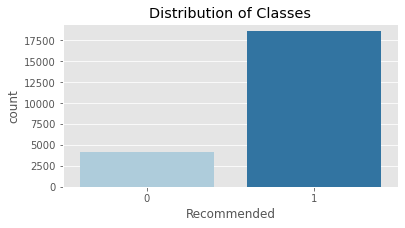

In [333]:
fig, ax = plt.subplots(figsize= (6,3))
sns.countplot(x='Recommended', data=text_df)
plt.title('Distribution of Classes')

In [415]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    random_state=0,
                                                    stratify=y, 
                                                    test_size=0.2)

In [430]:
X_test.index

Int64Index([15291,  9054, 18674,  8409, 16737,  1529, 10998,  8853, 14807,
            16304,
            ...
             6688,  2505,  7059,  9701, 16263, 15538,    48,  9102,  4122,
            14091],
           dtype='int64', length=4529)

In [438]:
X_test.loc[8409]

Review Text    A culotte and basketball short hybrid. these c...
Rating                                                         5
Name: 8409, dtype: object

In [439]:
text_df.loc[8409]

Review Text    A culotte and basketball short hybrid. these c...
Rating                                                         5
Recommended                                                    1
Name: 8409, dtype: object

In [417]:
y_test

15291    0
9054     1
18674    1
8409     1
16737    0
        ..
15538    0
48       1
9102     0
4122     1
14091    1
Name: Recommended, Length: 4529, dtype: int64

In [440]:
text_df.loc[16737]

Review Text    I bought this suit based on the great reviews....
Rating                                                         2
Recommended                                                    0
Name: 16737, dtype: object

In [434]:
y_test.loc[16737]

0

In [437]:
X_test.loc[16737]

Review Text    I bought this suit based on the great reviews....
Rating                                                         2
Name: 16737, dtype: object

## TF-IDF

In [342]:
# this seems to work well

tfidf = TfidfVectorizer(stop_words = stopwords.words('english') + added,
                                token_pattern = '[A-Za-z]+',
                                encoding = 'utf-8',
                                lowercase = True,
                                ngram_range = (1,2),
                                min_df = 2,
                       max_features= 5000)

X_train_transformed = tfidf.fit_transform(X_train.iloc[:,0]).todense()

#print(sorted(tfidf.vocabulary_), '\n')
#X= X.todense()
print(len(tfidf.vocabulary_))

5000


In [345]:
X_train.shape, X_train_transformed.shape, y_train.shape

((18112, 2), (18112, 5000), (18112,))

In [346]:
X_train_transformed

matrix([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]])

In [347]:
y_train

2214     1
14081    1
16363    1
9495     1
12374    1
        ..
295      1
22053    1
9484     0
693      1
6129     1
Name: Recommended, Length: 18112, dtype: int64

## Building Models:

### Random Forrest

In [349]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, precision_score, recall_score, accuracy_score, plot_confusion_matrix, classification_report

In [364]:
rf = RandomForestClassifier(n_estimators=500, random_state=0)
rf.fit(X_train_transformed, y_train) 


RandomForestClassifier(n_estimators=500, random_state=0)

In [358]:
X_test_transformed = tfidf.transform(X_test.iloc[:,0]).todense()
y_pred= rf.predict(X_test_transformed)

In [362]:
X_test_transformed.shape , X_train_transformed.shape , y_test.shape, y_train.shape

((4529, 5000), (18112, 5000), (4529,), (18112,))

In [359]:
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))


[[  55  765]
 [ 174 3535]]
              precision    recall  f1-score   support

           0       0.24      0.07      0.10       820
           1       0.82      0.95      0.88      3709

    accuracy                           0.79      4529
   macro avg       0.53      0.51      0.49      4529
weighted avg       0.72      0.79      0.74      4529

0.7926694634577169


### Logistic Regression

In [360]:
from sklearn.linear_model import LogisticRegression

In [366]:
lr = LogisticRegression()
lr.fit(X_train_transformed, y_train)


LogisticRegression()

In [368]:
y_test.shape

(4529,)

In [370]:
y_pred = lr.predict(X_test_transformed)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))

[[   8  812]
 [  25 3684]]
              precision    recall  f1-score   support

           0       0.24      0.01      0.02       820
           1       0.82      0.99      0.90      3709

    accuracy                           0.82      4529
   macro avg       0.53      0.50      0.46      4529
weighted avg       0.71      0.82      0.74      4529

0.8151909913888276


In [372]:
sum(y_test ==1)

3709

In [373]:
len(y_test)

4529

In [374]:
4529-3709

820

In [376]:
y_test ==0    

(15291     True
 9054     False
 18674    False
 8409     False
 16737     True
          ...  
 15538     True
 48       False
 9102      True
 4122     False
 14091    False
 Name: Recommended, Length: 4529, dtype: bool,
 array([False, False, False, ..., False, False, False]))

In [377]:
y_pred ==0

array([False, False, False, ..., False, False, False])

In [380]:
text_df.iloc[15291,:]

Review Text    I saw this skirt online and had to have it. as...
Rating                                                         4
Recommended                                                    0
Name: 15879, dtype: object

In [391]:
y_test

15291    0
9054     1
18674    1
8409     1
16737    0
        ..
15538    0
48       1
9102     0
4122     1
14091    1
Name: Recommended, Length: 4529, dtype: int64

In [392]:
frame ={'y_test': y_test}
dframe = pd.DataFrame(frame)

In [395]:
dframe['y_pred'] =y_pred
dframe

,y_test,y_pred
15291,0,1
9054,1,1
18674,1,1
8409,1,1
16737,0,1
...,...,...
15538,0,1
48,1,1
9102,0,1
4122,1,1


In [456]:
dframe[dframe['y_pred']== 1]

,y_test,y_pred
15291,0,1
9054,1,1
18674,1,1
8409,1,1
16737,0,1
...,...,...
15538,0,1
48,1,1
9102,0,1
4122,1,1


In [457]:
X_test.loc[15291, 'Review Text']

'This dress is good quality but the designers today really need to design their clothing line with the busty woman in mind.'

In [458]:
y_test.loc[15291]

0

In [459]:
text_df.loc[15291]

Review Text    This dress is good quality but the designers t...
Rating                                                         4
Recommended                                                    0
Name: 15291, dtype: object

## Getting into the business

In [461]:
df.shape

(23486, 10)

In [462]:
df.columns

Index(['Clothing ID', 'Age', 'Title', 'Review Text', 'Rating', 'Recommended',
       'Positive Feedback Count', 'Division Name', 'Department Name',
       'Class Name'],
      dtype='object')

In [470]:
grouped_df= df.groupby('Clothing ID')['Rating'].mean()
grouped_df = pd.DataFrame(grouped_df, columns= ['Rating'])
grouped_df

,Rating
Clothing ID,
0,5.000000
1,4.000000
2,4.000000
3,5.000000
4,5.000000
...,...
1201,4.000000
1202,4.333333
1203,4.545455


In [473]:
grouped_df['Review_Counts']= df.groupby('Clothing ID')['Rating'].count()
grouped_df.drop(columns=['Review Counts'], axis=1 , inplace= True)
grouped_df

,Rating,Review_Counts
Clothing ID,,
0,5.000000,1
1,4.000000,3
2,4.000000,1
3,5.000000,1
4,5.000000,1
...,...,...
1201,4.000000,2
1202,4.333333,9
1203,4.545455,11


In [474]:
grouped_df.Review_Counts.max()

1024

In [476]:
pd.set_option('display.max_rows', None)
grouped_df.sort_values(by='Review_Counts',ascending=False)

,Rating,Review_Counts
Clothing ID,,
1078,4.204102,1024
862,4.200993,806
1094,4.189153,756
1081,4.281787,582
872,4.383486,545
829,4.193548,527
1110,4.281250,480
868,3.946512,430
895,4.299505,404


In [479]:
grouped_df['Rating_sdv']= df.groupby('Clothing ID')['Rating'].std()
grouped_df.sort_values(by='Rating_sdv',ascending=False)

,Rating,Review_Counts,Rating_sdv
Clothing ID,,,
1007,3.000000,2,2.828427
250,3.000000,2,2.828427
768,3.000000,2,2.828427
232,3.000000,2,2.828427
306,3.000000,2,2.828427
363,3.666667,3,2.309401
971,3.400000,5,2.190890
1073,3.500000,2,2.121320
450,2.500000,2,2.121320


In [484]:
df[df['Clothing ID']==870]

,Clothing ID,Age,Title,Review Text,Rating,Recommended,Positive Feedback Count,Division Name,Department Name,Class Name
2202,870,39,Lovely,I purchased this shell in black. the embellish...,4,1,0,General,Tops,Knits
2218,870,37,Unexpected find,I tend to peruse the sale section when i am av...,5,1,0,General,Tops,Knits
2221,870,67,NaN,"I wanted to love it - the color is great, the ...",3,0,0,General,Tops,Knits
2225,870,29,Beautiful embroidery,"I tried this shirt and really loved the feel, ...",5,1,0,General,Tops,Knits
2243,870,43,Looks cheap,I was excited to receive this top. it looked g...,1,0,0,General,Tops,Knits
2532,870,29,Suprisingly great!,This was my first time to purchase and wear a ...,5,1,1,General,Tops,Knits
2538,870,68,Cute and comfy!,I am so pleased with this tunic. the fabric he...,5,1,0,General,Tops,Knits
2547,870,55,Lovelovelovelovelove*million,When i saw this in store i was so attracted to...,5,1,1,General,Tops,Knits
2552,870,35,NaN,Matronly and unflattering. i think this may wo...,2,0,0,General,Tops,Knits
2555,870,25,"Strange fit, nice fabric and stitching",I ordered this in my usual size small (36b bus...,2,0,1,General,Tops,Knits


In [494]:
grouped_df.dropna(inplace=True)

In [570]:
grouped_df = grouped_df[grouped_df['Review_Counts']>11]
grouped = grouped_df.sort_values(by='Rating_sdv',ascending=False)

In [688]:
new= grouped.reset_index()
new

,Clothing ID,Rating,Review_Counts,Rating_sdv
0,986,3.468750,32,1.665288
1,817,3.761905,21,1.513432
2,1122,3.647059,17,1.497547
3,1076,3.673913,46,1.491522
4,1088,3.566667,30,1.478194
5,1021,3.846154,13,1.463224
6,1116,3.714286,35,1.446526
7,838,3.594595,37,1.442595
8,1055,3.360000,25,1.439907
9,841,3.520000,25,1.417745


<AxesSubplot:xlabel='Rating_sdv', ylabel='Density'>

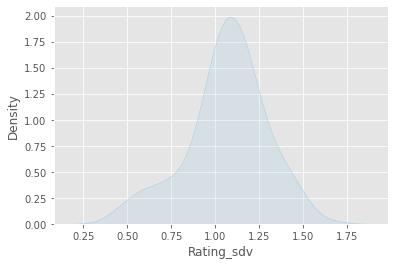

In [502]:
sns.kdeplot(grouped_df['Rating_sdv'],shade=True)

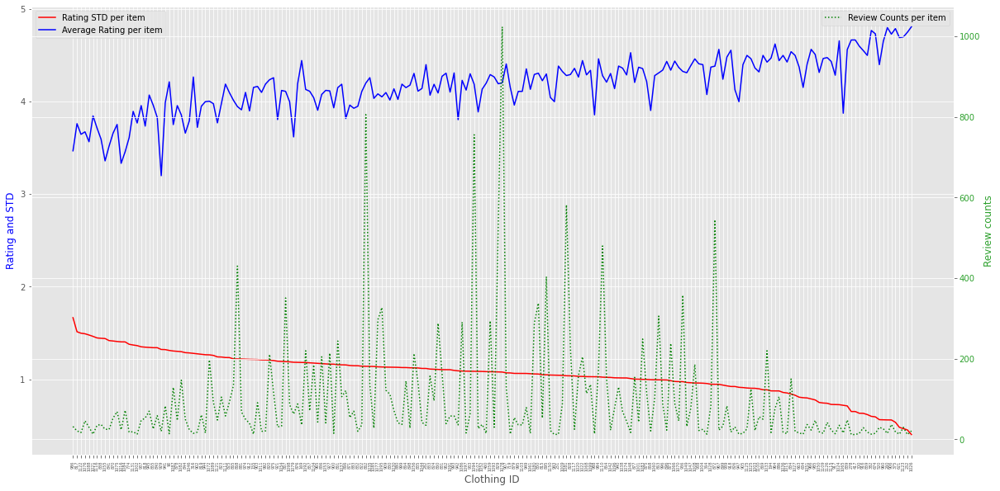

In [684]:
fig , ax = plt.subplots(figsize =(20,10))
ax.plot(new['Rating_sdv'], label='Rating STD per item', c= 'r')
ax.plot(new['Rating'], label= 'Average Rating per item', c = 'b')
ax.legend()
ax.set_xticklabels(new['Clothing ID'], rotation = 90)
ax.set_xticks(new.index)
ax.set_xlabel("Clothing ID")
ax.set_ylabel('Rating and STD', color='b') 
ax.tick_params(axis='x', labelsize=5)


ax2 = ax.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:green'
ax2.set_ylabel('Review counts', color=color)  # we already handled the x-label with ax1
ax2.plot(new['Review_Counts'], label= 'Review Counts per item', c = 'g', linestyle='dotted')
ax2.legend()
ax2.tick_params(axis='y', labelcolor=color)
plt.savefig('images/rating_std.png', dpi= 300)

AttributeError: 'PathCollection' object has no property 'hue'

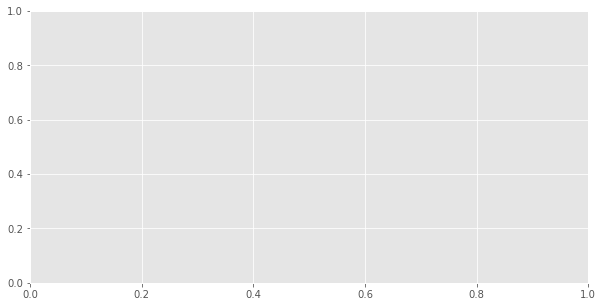

In [720]:
fig,ax= plt.subplots(figsize=(10,5))
ax.scatter(new['Review_Counts'],new['Rating'], hue = new['sdv+1'])
ax.set_xlabel('Review_Counts')
ax.set_ylabel('Average Rating')
plt.savefig('images/rating_count.png', dpi= 300)

In [722]:
#new['sdv+1'] = 0
new.loc[new["Rating_sdv"]>1,'sdv+1'] = 1
new

,Clothing ID,Rating,Review_Counts,Rating_sdv,sdv+1
0,986,3.468750,32,1.665288,1
1,817,3.761905,21,1.513432,1
2,1122,3.647059,17,1.497547,1
3,1076,3.673913,46,1.491522,1
4,1088,3.566667,30,1.478194,1
5,1021,3.846154,13,1.463224,1
6,1116,3.714286,35,1.446526,1
7,838,3.594595,37,1.442595,1
8,1055,3.360000,25,1.439907,1
9,841,3.520000,25,1.417745,1


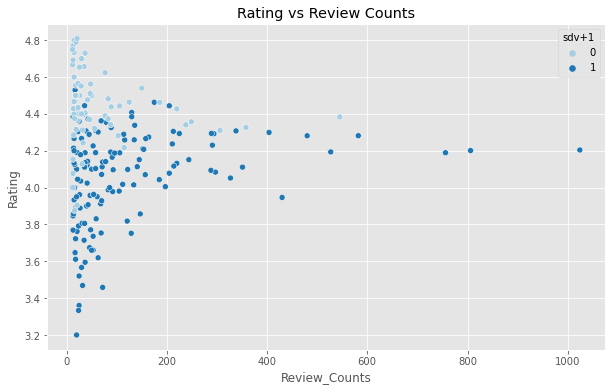

In [727]:
fig = plt.gcf()
fig.set_size_inches(10, 6)

sns.scatterplot(x='Review_Counts',y='Rating', hue = 'sdv+1', data = new).set(title='Rating vs Review Counts')
ax.set_xlabel('Review_Counts')
ax.set_ylabel('Average Rating')
plt.savefig('images/rating_count.png', dpi= 300)

In [693]:
new.shape

(210, 5)

In [569]:
grouped_df.sort_values(by='Rating', ascending= True)

,Rating,Review_Counts,Rating_sdv
Clothing ID,,,
229,2.181818,11,0.981650
884,3.181818,11,1.250454
929,3.200000,20,1.321881
482,3.272727,11,1.489356
1016,3.333333,24,1.403928
1055,3.360000,25,1.439907
1084,3.458333,72,1.403592
986,3.468750,32,1.665288
841,3.520000,25,1.417745


In [581]:
trial = grouped_df[grouped_df['Rating']<4]
trial= trial[trial['Rating_sdv']>1]
trial.sort_values(by='Review_Counts', ascending= False)

,Rating,Review_Counts,Rating_sdv
Clothing ID,,,
868,3.946512,430,1.219280
1082,3.857143,147,1.298049
1087,3.751938,129,1.305224
866,3.818182,121,1.154701
823,3.980952,105,1.240200
1089,3.978261,92,1.257752
941,3.987952,83,1.320513
1084,3.458333,72,1.403592
883,3.928571,70,1.146152


In [652]:
item_868= df[df["Clothing ID"] == 868]
item_868.head()

,Clothing ID,Age,Title,Review Text,Rating,Recommended,Positive Feedback Count,Division Name,Department Name,Class Name
173,868,51,Great for summer,Love this cream sleeveless top....it goes with...,4,1,0,General Petite,Tops,Knits
270,868,61,Nice color,I liked the color of this top but i didn't rea...,3,1,0,General,Tops,Knits
276,868,55,Pretty and feminine,Pretty top. love the color and the large ruffl...,5,1,0,General,Tops,Knits
277,868,83,Sooooooooo cute!,"Love this top!\nit is a full/ swing top, but t...",5,1,1,General,Tops,Knits
278,868,35,Peplum hem tee,The styling of this top is really cute. it fit...,3,1,2,General,Tops,Knits


In [670]:
item_868.sort_values(by="Positive Feedback Count", ascending = False).iloc[5,3]

"I purchased the green online, in my usual medium. i do like it but i will be returning it for a few reasons. first, i couldn't justify the price as it's really not unique enough. it kind of reminds me of a pajama top. also, i thought it was 3/4 sleeve, which it is not, it's long sleeve. and lastly, it appears to be regular length on the model. i'm maybe 5'4 at best and it's shorter and boxy. i gave it 4 stars because i really like it for what it is, but just not what i expected. it is cute, spor"

In [600]:
len(item_868)

430

In [602]:
# Taking out the rows with no review text
item_868 = item_868.dropna( how='any',
                    subset=['Review Text'])
len(item_868)

414

In [648]:
item_868.to_csv('data/item_868.csv')

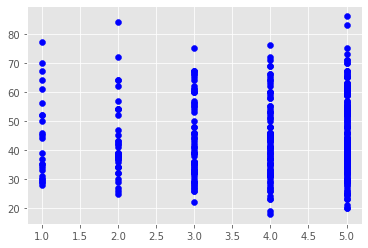

In [587]:
fig , ax = plt.subplots()
ax.scatter(item_868['Rating'],item_868['Age'], c= 'b')

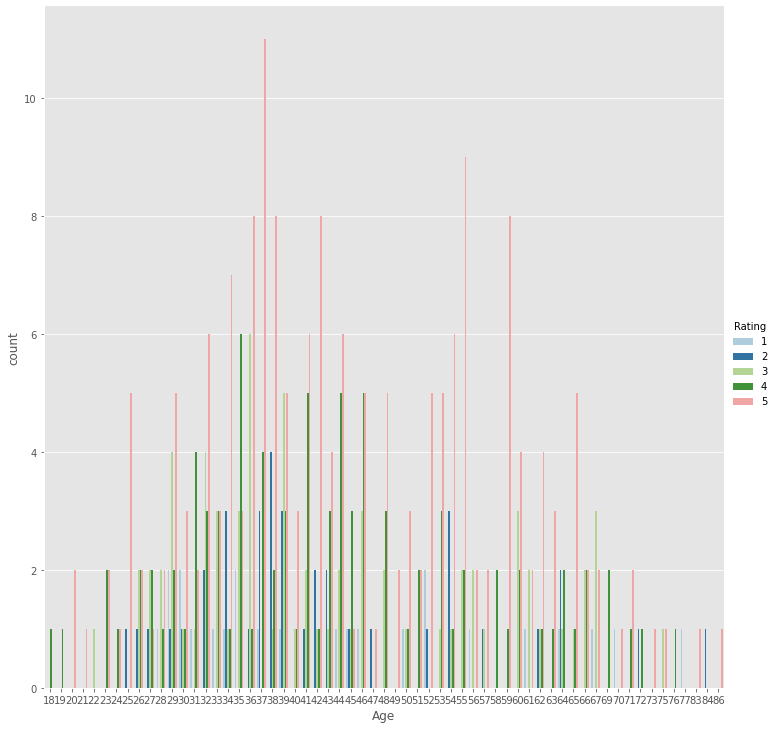

In [616]:
sns.catplot(data=item_868,kind='count',x='Age',hue='Rating',height = 10)

[Text(0.5, 1.0, 'Rating Counts for item 868')]

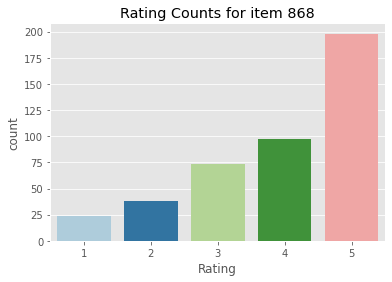

In [658]:
sns.countplot(x='Rating', data=item_868).set(title='Rating Counts for item 868')

## WordCloud

In [588]:
# What are people talking about

from nltk.corpus import stopwords
import string
from wordcloud import WordCloud

In [596]:
def creat_wordcloud(df, column, name):
    
    out = ' '.join(df[column])
    pt = string.punctuation + "''"
    sw = stopwords.words('english') +['im']

    for i in out: 
        if i in pt: 
            out = out.lower().replace(i, "")     

    #create word cloud
    wordcloud = WordCloud(min_font_size = 10, background_color ='white', stopwords = sw).generate(out) 

    # plot the WordCloud image
    plt.figure(figsize = (10, 10), facecolor = None) 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.savefig(f'images/{name}.png', dpi=300, bbox_inches='tight')

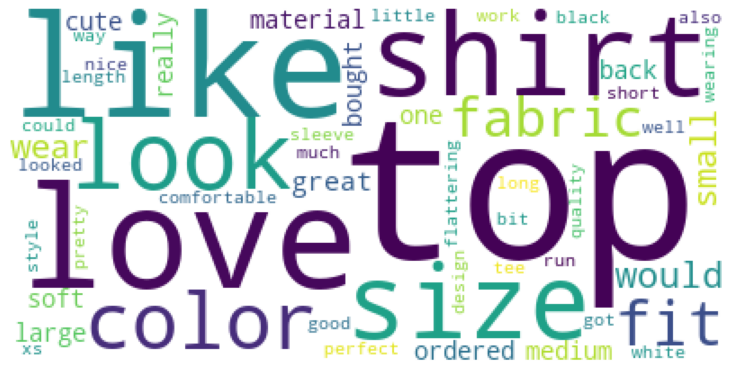

In [603]:
creat_wordcloud(item_868, 'Review Text', 'item868')

In [622]:
#pip install dataprep


  0%|          | 0/1108 [00:00<?, ?it/s]

My Report
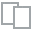
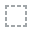
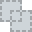
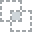
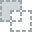
...
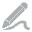
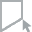
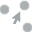
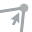
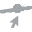

In [735]:
from dataprep.eda import create_report
report = create_report(item_868, title='My Report')
report

## LDA MODELING
#### Finding the latent topics

## Not workings:

In [268]:
# this doesn't seem to work 

from nltk.stem.porter import PorterStemmer

def tokenize(text):
    tokens = nltk.word_tokenize(text)
    stems = []
    for item in tokens:
        stems.append(PorterStemmer().stem(item))
    return stems

tfidf = TfidfVectorizer(tokenizer = tokenize,
    stop_words = stopwords.words('english') + added,
                                token_pattern = '[A-Za-z]+',
                                encoding = 'utf-8',
                                lowercase = True,
                                ngram_range = (1,2),
                                min_df = 2)

document_tfidf_matrix = tfidf.fit_transform(text_df.iloc[:15,0])

print(sorted(tfidf.vocabulary_), '\n')

['!', "'", "''", "'m", "'m 5", "'s", '(', ')', ') .', ',', ', petit', '-', '.', '. love', '. order', '5', "5 '", 'becaus', 'big', 'bought', 'bust', 'cheap', 'color', 'color realli', 'comfort', 'could', 'definit', 'doe', 'dress', 'dress .', 'even', 'everyth', 'fabric', 'find', 'fit', 'flatter', 'get', 'go', 'half', 'hte', 'kept', 'knee', 'knee .', 'layer', 'length', 'like', 'line', 'littl', 'long', 'look', 'love', 'love thi', 'midi', "n't", 'net', 'nice', 'onli', 'order', 'order petit', 'pair', 'pant', 'pant ,', 'perfect', 'petit', 'petit .', 'pick', 'pretti', 'qualiti', 'qualiti .', 'realli', 'retail', 'run', 'run small', 'say', 'size', 'size (', 'skirt', 'small', 'snug', 'store', 'store pick', 'style', 'thi', 'thi dress', 'tight', 'top', 'tri', 'typic', 'usual', 'usual size', 'veri', 'veri flatter', 'veri pretti', 'veri tight', 'wa', 'wa veri', 'wear', 'well', 'went', 'work', 'work .', 'xs', 'zip', 'zipper'] 



/Users/bahar/opt/anaconda3/lib/python3.8/site-packages/sklearn/feature_extraction/text.py:388: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", 'abov', 'ani', 'becaus', 'befor', 'could', 'doe', 'dure', 'ha', 'hi', 'might', 'must', "n't", 'need', 'onc', 'onli', 'ourselv', 'realli', 'sha', 'themselv', 'thi', 'veri', 'wa', 'whi', 'wo', 'yourselv'] not in stop_words.
  warnings.warn('Your stop_words may be inconsistent with '


In [207]:
# Pre processing the text data:

def preprocess(text):
    
    # normalize
    text = unicodedata.normalize('NFKD', text).encode('ASCII','ignore').decode('ASCII')
    
    #tokenizing and lowercase:
    words = [word_tokenize(s.lower()) for s in sent_tokenize(text)]
    
    # take out stopwords and punctuation:
    sw = stopwords.words('english')
    pt = string.punctuation + "''"
    
    tokens = [word for word in words if word not in sw and word not in pt]
    
    # Stemming
    
    return tokens



In [277]:
# not so well

from sklearn.feature_extraction.text import TfidfVectorizer
from nltk import word_tokenize     
from nltk.stem import WordNetLemmatizer 

class LemmaTokenizer(object):
    pt = string.punctuation + "''"
    def __init__(self):
        self.wnl = WordNetLemmatizer()
    def __call__(self, articles):
        return [self.wnl.lemmatize(t) for t in word_tokenize(articles) if t not in self.pt]

tfidf = TfidfVectorizer(tokenizer = LemmaTokenizer(),
                                stop_words = stopwords.words('english') + added,
                                token_pattern = '[A-Za-z]+',
                                encoding = 'utf-8',
                                lowercase = True,
                                ngram_range = (1,2),
                                min_df =0)

document_tfidf_matrix = tfidf.fit_transform(text_df)

#print(sorted(tfidf.vocabulary_), '\n')
#print(document_tfidf_matrix.todense())